# Nerfies Dataset Processing.

**Author**: [Keunhong Park](https://keunhong.com)

[[Project Page](https://nerfies.github.io)]
[[Paper](https://storage.googleapis.com/nerfies-public/videos/nerfies_paper.pdf)]
[[Video](https://www.youtube.com/watch?v=MrKrnHhk8IA)]
[[GitHub](https://github.com/google/nerfies)]

This notebook contains an example workflow for converting a video file to a Nerfies dataset.

### Instructions

1. Convert a video into our dataset format using this notebook.
2. Train a Nerfie using the [training notebook](https://colab.sandbox.google.com/github/google/nerfies/blob/main/notebooks/Nerfies_Training.ipynb).


### Notes
* While this will work for small datasets in a Colab runtime, larger datasets will require more compute power.
* If you would like to train a model on a serious dataset, you should consider copying this to your own workstation and running it there. Some minor modifications will be required, and you will have to install the dependencies separately.
* Please report issues on the [GitHub issue tracker](https://github.com/google/nerfies/issues).

If you find this work useful, please consider citing:
```bibtex
@article{park2021nerfies
  author    = {Park, Keunhong 
               and Sinha, Utkarsh 
               and Barron, Jonathan T. 
               and Bouaziz, Sofien 
               and Goldman, Dan B 
               and Seitz, Steven M. 
               and Martin-Brualla, Ricardo},
  title     = {Nerfies: Deformable Neural Radiance Fields},
  journal   = {ICCV},
  year      = {2021},
}
```

In [17]:
from pathlib import Path
import concurrent.futures
import numpy as np
import cv2
import imageio
from PIL import Image
import pdb

## Configuration.

Mount Google Drive onto `/content/gdrive`. You can skip this if you want to run this locally.

In [18]:
# @markdown The base directory for all captures. This can be anything if you're running this notebook on your own Jupyter runtime.
save_dir = './data/nerf_bm'  # @param {type: 'string'}
# @markdown The name of this capture. The working directory will be `$save_dir/$capture_name`. **Make sure you change this** when processing a new video.
capture_name = 'giraffe'  # @param {type: 'string'}
# The root directory for this capture.
root_dir = Path(save_dir, capture_name)
# Where to save RGB images.
rgb_dir = root_dir / 'rgb'
rgb_raw_dir = root_dir / 'images'

# Where to save the COLMAP outputs.
colmap_dir = root_dir
colmap_db_path = colmap_dir / 'database.db'
colmap_out_path = colmap_dir / 'sparse'

colmap_out_path.mkdir(exist_ok=True, parents=True)
rgb_raw_dir.mkdir(exist_ok=True, parents=True)

print(f"""Directories configured:
  root_dir = {root_dir}
  rgb_raw_dir = {rgb_raw_dir}
  rgb_dir = {rgb_dir}
  colmap_dir = {colmap_dir}
""")

tmp_rgb_raw_dir = rgb_raw_dir



Directories configured:
  root_dir = data/nerf_bm/giraffe
  rgb_raw_dir = data/nerf_bm/giraffe/images
  rgb_dir = data/nerf_bm/giraffe/rgb
  colmap_dir = data/nerf_bm/giraffe



## Dataset Processing.

### Load Video.

In this step we upload a video file and flatten it into PNG files using ffmpeg.

In [19]:
# @title Resize images into different scales.
# @markdown Here we save the input images at various resolutions (downsample by a factor of 1, 2, 4, 8). We use area relation interpolation to prevent moire artifacts.




def save_image(path, image: np.ndarray) -> None:
  print(f'Saving {path}')
  if not path.parent.exists():
    path.parent.mkdir(exist_ok=True, parents=True)
  with path.open('wb') as f:
    image = Image.fromarray(np.asarray(image))
    image.save(f, format=path.suffix.lstrip('.'))


def image_to_uint8(image: np.ndarray) -> np.ndarray:
  """Convert the image to a uint8 array."""
  if image.dtype == np.uint8:
    return image
  if not issubclass(image.dtype.type, np.floating):
    raise ValueError(
        f'Input image should be a floating type but is of type {image.dtype!r}')
  return (image * 255).clip(0.0, 255).astype(np.uint8)


def make_divisible(image: np.ndarray, divisor: int) -> np.ndarray:
  """Trim the image if not divisible by the divisor."""
  height, width = image.shape[:2]
  if height % divisor == 0 and width % divisor == 0:
    return image

  new_height = height - height % divisor
  new_width = width - width % divisor

  return image[:new_height, :new_width]


def downsample_image(image: np.ndarray, scale: int) -> np.ndarray:
  """Downsamples the image by an integer factor to prevent artifacts."""
  if scale == 1:
    return image

  height, width = image.shape[:2]
  if height % scale > 0 or width % scale > 0:
    raise ValueError(f'Image shape ({height},{width}) must be divisible by the'
                     f' scale ({scale}).')
  out_height, out_width = height // scale, width // scale
  resized = cv2.resize(image, (out_width, out_height), cv2.INTER_AREA)
  return resized



image_scales = "1"  # @param {type: "string"}
image_scales = [int(x) for x in image_scales.split(',')]

for image_path in Path(tmp_rgb_raw_dir).glob('*_crop.jpg'):
  image = make_divisible(imageio.imread(image_path), max(image_scales))
  for scale in image_scales:
    save_image(
        rgb_dir / f'{scale}x/{image_path.stem}.png',
        image_to_uint8(downsample_image(image, scale)))


Saving data/nerf_bm/giraffe/rgb/1x/C02371_000462_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000112_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000616_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000712_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000088_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000696_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000136_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000072_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000320_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000232_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000424_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C0235_000763_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000592_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C0235_000824_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000120_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000264_crop.png
Saving data/nerf_bm/giraffe/rgb/1x/C02372_000432_crop.png
Saving data/nerf

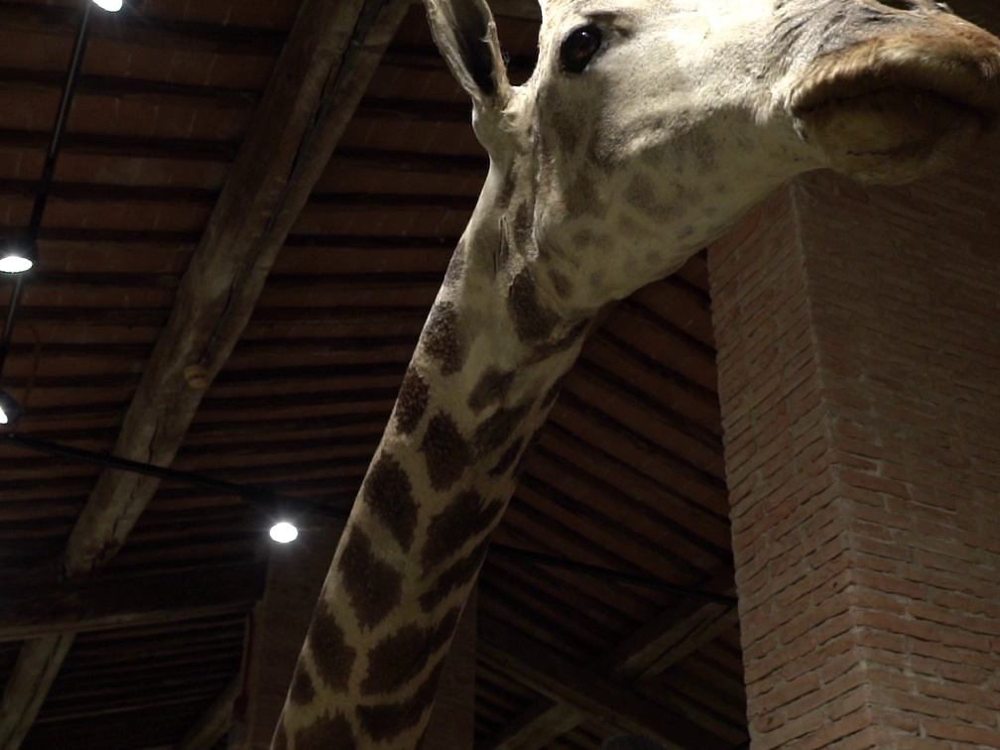

In [20]:
# @title Example frame.
# @markdown Make sure that the video was processed correctly.
# @markdown If this gives an exception, try running the preceding cell one more time--sometimes uploading to Google Drive can fail.

image_paths = list((rgb_dir / '1x').iterdir())
Image.open(image_paths[0])

In [21]:
colmap_image_scale = 1  # @param {type: 'number'}

### Camera registration with COLMAP.

In [22]:
# @title Extract features.
# @markdown Computes SIFT features and saves them to the COLMAP DB.
share_intrinsics = True  # @param {type: 'boolean'}
assume_upright_cameras = True  # @param {type: 'boolean'}

# @markdown This sets the scale at which we will run COLMAP. A scale of 1 will be more accurate but will be slow.
colmap_rgb_dir = rgb_dir / f'{colmap_image_scale}x'

# @markdown Check this if you want to re-process SfM.
overwrite = True  # @param {type: 'boolean'}

if overwrite and colmap_db_path.exists():
  colmap_db_path.unlink()

!colmap feature_extractor \
--SiftExtraction.use_gpu 0 \
--SiftExtraction.upright {int(assume_upright_cameras)} \
--ImageReader.camera_model OPENCV \
--ImageReader.single_camera {int(share_intrinsics)} \
--database_path "{str(colmap_db_path)}" \
--image_path "{str(colmap_rgb_dir)}"

# !colmap feature_extractor \
# --SiftExtraction.use_gpu 0 \
# --SiftExtraction.upright {int(assume_upright_cameras)} \
# --ImageReader.camera_model SIMPLE_RADIAL \
# --ImageReader.single_camera {int(share_intrinsics)} \
# --database_path "{str(colmap_db_path)}" \
# --image_path "{str(colmap_rgb_dir)}"


Feature extraction

Processed file [1/138]
  Name:            C0235_000183_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2079
Processed file [2/138]
  Name:            C0235_000127_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2314
Processed file [3/138]
  Name:            C0235_000000_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2482
Processed file [4/138]
  Name:            C0235_000307_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        1800
Processed file [5/138]
  Name:            C0235_000364_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        1786
Processed file [6/138]
  Name:            C0235_000231_crop.png
  Dimensions:      1008 x

Processed file [46/138]
  Name:            C02372_000104_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2789
Processed file [47/138]
  Name:            C02372_000128_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2715
Processed file [48/138]
  Name:            C02372_000136_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2686
Processed file [49/138]
  Name:            C02372_000144_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2689
Processed file [50/138]
  Name:            C02372_000152_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2663
Processed file [51/138]
  Name:            C02372_000160_crop.png
  Dimensions:      1008 x 756
  Ca

Processed file [94/138]
  Name:            C02372_000504_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2184
Processed file [95/138]
  Name:            C02372_000512_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2115
Processed file [96/138]
  Name:            C02372_000520_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2118
Processed file [97/138]
  Name:            C02372_000528_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2107
Processed file [98/138]
  Name:            C02372_000536_crop.png
  Dimensions:      1008 x 756
  Camera:          #1 - OPENCV
  Focal Length:    1209.60px
  Features:        2172
Processed file [99/138]
  Name:            C02372_000544_crop.png
  Dimensions:      1008 x 756
  Ca

In [23]:
# @title Match features.
# @markdown Match the SIFT features between images. Use `exhaustive` if you only have a few images and use `vocab_tree` if you have a lot of images.

match_method = 'exhaustive'  # @param ["exhaustive", "vocab_tree"]

if match_method == 'exhaustive':
  !colmap exhaustive_matcher \
    --SiftMatching.use_gpu 0 \
    --database_path "{str(colmap_db_path)}"
else:
  # Use this if you have lots of frames.
  !wget https://demuc.de/colmap/vocab_tree_flickr100K_words32K.bin
  !colmap vocab_tree_matcher \
    --VocabTreeMatching.vocab_tree_path vocab_tree_flickr100K_words32K.bin \
    --SiftMatching.use_gpu 0 \
    --database_path "{str(colmap_db_path)}"


Exhaustive feature matching

Matching block [1/3, 1/3] in 122.810s
Matching block [1/3, 2/3] in 145.753s
Matching block [1/3, 3/3] in 65.156s
Matching block [2/3, 1/3] in 133.758s
Matching block [2/3, 2/3] in 159.785s
Matching block [2/3, 3/3] in 69.146s
Matching block [3/3, 1/3] in 130.955s
Matching block [3/3, 2/3] in 163.268s
Matching block [3/3, 3/3] in 83.030s
Elapsed time: 17.901 [minutes]


In [24]:
# @title Reconstruction.
# @markdown Run structure-from-motion to compute camera parameters.

refine_principal_point = True  #@param {type:"boolean"}
min_num_matches = 32 # @param {type: 'number'}
filter_max_reproj_error = 2  # @param {type: 'number'}
tri_complete_max_reproj_error = 2  # @param {type: 'number'}

!colmap mapper \
  --Mapper.ba_refine_principal_point {int(refine_principal_point)} \
  --Mapper.filter_max_reproj_error $filter_max_reproj_error \
  --Mapper.tri_complete_max_reproj_error $tri_complete_max_reproj_error \
  --Mapper.min_num_matches $min_num_matches \
  --database_path "{str(colmap_db_path)}" \
  --image_path "{str(colmap_rgb_dir)}" \
  --output_path "{str(colmap_out_path)}" # renamed to output path


Loading database

Loading cameras... 1 in 0.000s
Loading matches... 8777 in 0.116s
Loading images... 138 in 0.020s (connected 138)
Building correspondence graph... in 1.938s (ignored 249)

Elapsed time: 0.035 [minutes]


Initializing with image pair #62 and #2


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.010326e+01    0.00e+00    1.42e+04   0.00e+00   0.00e+00  1.00e+04        0    9.62e-04    1.81e-03
   1  6.442543e+00    4.37e+01    1.33e+04   1.78e+01   9.17e-01  2.39e+04        1    7.16e-04    2.55e-03
   2  2.182420e+00    4.26e+00    5.40e+02   5.98e+00   9.88e-01  7.16e+04        1    5.20e-04    3.09e-03
   3  2.032205e+00    1.50e-01    1.22e+03   9.14e+00   7.90e-01  8.90e+04        1    4.91e-04    3.60e-03
   4  1.969856e+00    6.23e-02    4.90e+02   7.48e+00   8.38e-01  1.29e+05        1    5.99e-04    4.21e-03
   5  2.027665e+00   -5.78e-02    0.00e+00   8.05e+00  -1.51e+

  => Could not register, trying another image.

Registering image #66 (3)

  => Image sees 80 / 2332 points
  => Could not register, trying another image.

Registering image #54 (3)

  => Image sees 76 / 2625 points
  => Could not register, trying another image.

Registering image #64 (3)

  => Image sees 78 / 2347 points
  => Could not register, trying another image.

Registering image #18 (3)

  => Image sees 78 / 2292 points
  => Could not register, trying another image.

Registering image #63 (3)

  => Image sees 76 / 2382 points
  => Could not register, trying another image.

Registering image #34 (3)

  => Image sees 70 / 3030 points
  => Could not register, trying another image.

Registering image #20 (3)

  => Image sees 67 / 2558 points
  => Could not register, trying another image.

Registering image #32 (3)

  => Image sees 69 / 2709 points
  => Could not register, trying another image.

Registering image #38 (3)

  => Image sees 73 / 3120 points
  => Could not register, try

  79  1.806040e+00    1.23e-04    2.46e+01   2.38e+00   6.21e-01  1.60e+06        1    9.40e-04    4.48e-02
  80  1.805920e+00    1.19e-04    2.44e+01   2.36e+00   6.22e-01  1.63e+06        1    1.60e-03    4.64e-02
  81  1.805804e+00    1.17e-04    2.42e+01   2.35e+00   6.22e-01  1.65e+06        1    5.83e-04    4.70e-02
  82  1.805690e+00    1.14e-04    2.41e+01   2.33e+00   6.23e-01  1.68e+06        1    5.81e-04    4.76e-02
  83  1.805579e+00    1.11e-04    2.39e+01   2.32e+00   6.24e-01  1.70e+06        1    5.41e-04    4.82e-02
  84  1.805472e+00    1.08e-04    2.37e+01   2.30e+00   6.25e-01  1.73e+06        1    5.38e-04    4.87e-02
  85  1.805367e+00    1.05e-04    2.36e+01   2.29e+00   6.26e-01  1.76e+06        1    5.20e-04    4.92e-02
  86  1.805265e+00    1.02e-04    2.34e+01   2.27e+00   6.27e-01  1.79e+06        1    5.20e-04    4.98e-02
  87  1.805166e+00    9.92e-05    2.33e+01   2.25e+00   6.28e-01  1.82e+06        1    5.62e-04    5.04e-02
  88  1.805069e+00    9.64e-

  => Could not register, trying another image.

Registering image #84 (3)

  => Image sees 76 / 2235 points
  => Could not register, trying another image.

Registering image #25 (3)

  => Image sees 69 / 2154 points
  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 64 / 2208 points
  => Could not register, trying another image.

Registering image #87 (3)

  => Image sees 68 / 2164 points
  => Could not register, trying another image.

Registering image #46 (3)

  => Image sees 65 / 2751 points
  => Could not register, trying another image.

Registering image #39 (3)

  => Image sees 68 / 3137 points
  => Could not register, trying another image.

Registering image #78 (3)

  => Image sees 73 / 2249 points
  => Could not register, trying another image.

Registering image #53 (3)

  => Image sees 66 / 2657 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 68 / 2541 points
  => Could not register, try

  44  4.252625e+02    6.34e+00    1.37e+04   3.67e+01   7.23e-01  1.48e+04        1    1.60e-03    7.30e-02
  45  4.204064e+02    4.86e+00    3.06e+04   2.44e+01   6.55e-01  1.53e+04        1    2.08e-03    7.51e-02
  46  4.155447e+02    4.86e+00    3.37e+04   1.53e+01   6.88e-01  1.61e+04        1    1.55e-03    7.66e-02
  47  4.105146e+02    5.03e+00    3.18e+04   1.09e+01   7.18e-01  1.76e+04        1    1.47e-03    7.81e-02
  48  4.046500e+02    5.86e+00    2.65e+04   1.01e+01   7.51e-01  2.01e+04        1    1.52e-03    7.97e-02
  49  3.973207e+02    7.33e+00    1.47e+04   1.20e+01   7.30e-01  2.23e+04        1    1.48e-03    8.12e-02
  50  3.893515e+02    7.97e+00    1.61e+04   1.44e+01   5.42e-01  2.23e+04        1    1.47e-03    8.27e-02
  51  3.851280e+02    4.22e+00    6.19e+04   1.67e+01   1.77e-01  1.76e+04        1    1.52e-03    8.42e-02
  52  3.662196e+02    1.89e+01    7.40e+04   2.17e+01   4.93e-01  1.76e+04        1    1.49e-03    8.57e-02
  53  3.632705e+02    2.95e+

  => Could not register, trying another image.

Registering image #80 (3)

  => Image sees 240 / 2208 points
  => Could not register, trying another image.

Registering image #77 (3)

  => Image sees 235 / 2248 points
  => Could not register, trying another image.

Registering image #79 (3)

  => Image sees 253 / 2248 points
  => Could not register, trying another image.

Registering image #73 (3)

  => Image sees 237 / 2255 points
  => Could not register, trying another image.

Registering image #36 (3)

  => Image sees 209 / 3121 points
  => Could not register, trying another image.

Registering image #85 (3)

  => Image sees 239 / 2210 points
  => Could not register, trying another image.

Registering image #62 (3)

  => Image sees 230 / 2322 points
  => Could not register, trying another image.

Registering image #55 (3)

  => Image sees 213 / 2670 points
  => Could not register, trying another image.

Registering image #59 (3)

  => Image sees 214 / 2541 points
  => Could not regi

  42  2.646724e+01    7.92e-02    5.79e+03   1.54e+01   5.89e-02  6.29e+04        1    2.63e-03    7.19e-02
  43  2.513848e+01    1.33e+00    2.71e+03   1.17e+01   8.39e-01  9.15e+04        1    1.55e-03    7.35e-02
  44  2.546660e+01   -3.28e-01    0.00e+00   1.85e+01  -4.70e-01  4.58e+04        1    1.35e-03    7.48e-02
  45  2.472922e+01    4.09e-01    1.52e+03   9.42e+00   8.41e-01  6.72e+04        1    1.45e-03    7.63e-02
  46  2.464309e+01    8.61e-02    3.05e+03   1.47e+01   2.11e-01  5.63e+04        1    1.53e-03    7.78e-02
  47  2.419758e+01    4.46e-01    2.13e+03   1.40e+01   7.42e-01  6.35e+04        1    1.54e-03    7.94e-02
  48  2.395802e+01    2.40e-01    2.53e+03   1.68e+01   5.21e-01  6.35e+04        1    1.64e-03    8.11e-02
  49  2.363417e+01    3.24e-01    2.35e+03   1.80e+01   6.30e-01  6.46e+04        1    1.61e-03    8.27e-02
  50  2.333006e+01    3.04e-01    2.22e+03   1.90e+01   6.38e-01  6.60e+04        1    1.56e-03    8.43e-02
  51  2.303656e+01    2.93e-

  30  1.095033e+01    2.37e-02    7.75e+02   2.39e+01   5.98e-01  1.63e+05        1    3.12e-03    5.33e-02
  31  1.092706e+01    2.33e-02    7.72e+02   2.39e+01   5.97e-01  1.64e+05        1    1.52e-03    5.48e-02
  32  1.090419e+01    2.29e-02    7.68e+02   2.39e+01   5.96e-01  1.65e+05        1    1.53e-03    5.64e-02
  33  1.088172e+01    2.25e-02    7.64e+02   2.39e+01   5.95e-01  1.66e+05        1    1.64e-03    5.80e-02
  34  1.085965e+01    2.21e-02    7.59e+02   2.39e+01   5.94e-01  1.67e+05        1    1.54e-03    5.96e-02
  35  1.083798e+01    2.17e-02    7.55e+02   2.38e+01   5.93e-01  1.68e+05        1    1.58e-03    6.12e-02
  36  1.081671e+01    2.13e-02    7.51e+02   2.38e+01   5.92e-01  1.69e+05        1    1.46e-03    6.27e-02
  37  1.079583e+01    2.09e-02    7.46e+02   2.38e+01   5.91e-01  1.70e+05        1    1.45e-03    6.41e-02
  38  1.077534e+01    2.05e-02    7.41e+02   2.37e+01   5.91e-01  1.71e+05        1    1.61e-03    6.58e-02
  39  1.075523e+01    2.01e-

  => Could not register, trying another image.

Registering image #88 (3)

  => Image sees 237 / 2128 points
  => Could not register, trying another image.

Registering image #41 (3)

  => Image sees 201 / 2562 points
  => Could not register, trying another image.

Registering image #47 (3)

  => Image sees 209 / 2687 points
  => Could not register, trying another image.

Registering image #48 (3)

  => Image sees 202 / 2639 points
  => Could not register, trying another image.

Registering image #40 (3)

  => Image sees 190 / 2915 points
  => Could not register, trying another image.

Registering image #93 (3)

  => Image sees 235 / 2140 points
  => Could not register, trying another image.

Registering image #51 (3)

  => Image sees 209 / 2676 points
  => Could not register, trying another image.

Registering image #49 (3)

  => Image sees 205 / 2651 points
  => Could not register, trying another image.

Registering image #24 (3)

  => Image sees 174 / 2547 points
  => Could not regi

  93  1.830451e+01    2.33e-02    1.49e+03   1.28e+01   6.48e-01  1.46e+05        1    2.11e-03    6.45e-02
  94  1.828306e+01    2.14e-02    1.40e+03   1.22e+01   6.53e-01  1.51e+05        1    6.20e-04    6.51e-02
  95  1.826308e+01    2.00e-02    1.35e+03   1.18e+01   6.59e-01  1.56e+05        1    5.85e-04    6.57e-02
  96  1.824429e+01    1.88e-02    1.32e+03   1.14e+01   6.66e-01  1.62e+05        1    6.50e-04    6.64e-02
  97  1.822647e+01    1.78e-02    1.33e+03   1.12e+01   6.73e-01  1.69e+05        1    6.19e-04    6.70e-02
  98  1.820943e+01    1.70e-02    1.36e+03   1.10e+01   6.79e-01  1.77e+05        1    6.55e-04    6.77e-02
  99  1.819300e+01    1.64e-02    1.41e+03   1.10e+01   6.84e-01  1.86e+05        1    6.24e-04    6.83e-02
 100  1.817708e+01    1.59e-02    1.48e+03   1.10e+01   6.87e-01  1.96e+05        1    6.18e-04    6.89e-02


Bundle adjustment report
------------------------
    Residuals : 448
   Parameters : 349
   Iterations : 101
         Time : 0.069020

   8  1.811138e+01    1.36e-02    4.40e+02   1.21e+01   6.41e-01  2.37e+05        1    1.84e-03    7.96e-03
   9  1.809723e+01    1.41e-02    4.42e+02   1.21e+01   6.59e-01  2.45e+05        1    6.02e-04    8.58e-03
  10  1.808422e+01    1.30e-02    4.56e+02   1.22e+01   6.35e-01  2.50e+05        1    6.77e-04    9.29e-03
  11  1.807177e+01    1.24e-02    4.58e+02   1.22e+01   6.29e-01  2.54e+05        1    6.71e-04    9.99e-03
  12  1.806014e+01    1.16e-02    4.58e+02   1.21e+01   6.17e-01  2.57e+05        1    6.59e-04    1.07e-02
  13  1.804927e+01    1.09e-02    4.53e+02   1.21e+01   6.09e-01  2.60e+05        1    6.41e-04    1.13e-02
  14  1.803915e+01    1.01e-02    4.46e+02   1.20e+01   6.01e-01  2.62e+05        1    6.22e-04    1.20e-02
  15  1.802974e+01    9.41e-03    4.36e+02   1.19e+01   5.96e-01  2.64e+05        1    6.51e-04    1.27e-02
  16  1.802099e+01    8.74e-03    4.25e+02   1.19e+01   5.92e-01  2.66e+05        1    6.55e-04    1.33e-02
  17  1.801287e+01    8.13e-

  85  1.763893e+01    5.60e-03    3.82e+02   1.81e+01   5.22e-01  3.28e+05        1    1.94e-03    5.86e-02
  86  1.763333e+01    5.60e-03    3.81e+02   1.82e+01   5.21e-01  3.28e+05        1    5.95e-04    5.92e-02
  87  1.762774e+01    5.59e-03    3.81e+02   1.83e+01   5.21e-01  3.28e+05        1    6.56e-04    5.99e-02
  88  1.762216e+01    5.58e-03    3.81e+02   1.83e+01   5.20e-01  3.28e+05        1    5.93e-04    6.05e-02
  89  1.761658e+01    5.58e-03    3.80e+02   1.84e+01   5.20e-01  3.28e+05        1    6.33e-04    6.11e-02
  90  1.761101e+01    5.57e-03    3.80e+02   1.85e+01   5.20e-01  3.28e+05        1    6.31e-04    6.18e-02
  91  1.760545e+01    5.56e-03    3.80e+02   1.86e+01   5.19e-01  3.28e+05        1    6.49e-04    6.24e-02
  92  1.759990e+01    5.55e-03    3.79e+02   1.87e+01   5.19e-01  3.28e+05        1    6.56e-04    6.31e-02
  93  1.759435e+01    5.55e-03    3.79e+02   1.87e+01   5.18e-01  3.28e+05        1    6.75e-04    6.38e-02
  94  1.758881e+01    5.54e-


Initializing with image pair #108 and #16


Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  5.120478e+01    0.00e+00    6.50e+03   0.00e+00   0.00e+00  1.00e+04        0    4.41e-04    2.00e-03
   1  4.307254e+01    8.13e+00    1.28e+02   8.45e-01   9.98e-01  3.00e+04        1    1.36e-03    3.39e-03
   2  4.290276e+01    1.70e-01    1.10e+02   2.13e+00   1.01e+00  9.00e+04        1    1.10e-03    4.51e-03
   3  4.287260e+01    3.02e-02    3.01e+02   5.83e+00   9.31e-01  2.49e+05        1    1.07e-03    5.60e-03
   4  4.285936e+01    1.32e-02    1.12e+03   1.05e+01   3.64e-01  2.44e+05        1    1.09e-03    6.70e-03
   5  4.282731e+01    3.21e-02    8.43e+02   7.82e+00   6.70e-01  2.54e+05        1    1.08e-03    7.79e-03
   6  4.280765e+01    1.97e-02    8.08e+02   6.93e+00   4.89e-01  2.54e+05        1    9.80e-04    8.79e-03
   7  4.278598e+01    2.17e-02    7.63e+02   6.40e+00   4.84e-01 

  81  4.188893e+01    6.01e-03    2.69e+02   4.22e+00   5.64e-01  3.32e+05        1    1.33e-03    8.84e-02
  82  4.188302e+01    5.91e-03    2.64e+02   4.20e+00   5.66e-01  3.33e+05        1    1.86e-03    9.03e-02
  83  4.187722e+01    5.80e-03    2.59e+02   4.17e+00   5.69e-01  3.34e+05        1    1.22e-03    9.15e-02
  84  4.187151e+01    5.70e-03    2.54e+02   4.15e+00   5.71e-01  3.35e+05        1    1.20e-03    9.28e-02
  85  4.186591e+01    5.60e-03    2.49e+02   4.12e+00   5.73e-01  3.36e+05        1    1.24e-03    9.40e-02
  86  4.186040e+01    5.50e-03    2.44e+02   4.10e+00   5.75e-01  3.37e+05        1    1.17e-03    9.52e-02
  87  4.185500e+01    5.41e-03    2.39e+02   4.08e+00   5.77e-01  3.38e+05        1    1.14e-03    9.64e-02
  88  4.184969e+01    5.31e-03    2.35e+02   4.05e+00   5.79e-01  3.40e+05        1    1.23e-03    9.76e-02
  89  4.184447e+01    5.22e-03    2.30e+02   4.03e+00   5.81e-01  3.41e+05        1    1.26e-03    9.89e-02
  90  4.183934e+01    5.12e-

  => Added observations: 1473

Bundle adjustment report
------------------------
    Residuals : 11746
   Parameters : 6250
   Iterations : 15
         Time : 0.23864 [s]
 Initial cost : 0.171748 [px]
   Final cost : 0.161352 [px]
  Termination : Convergence

  => Merged observations: 6
  => Completed observations: 37
  => Filtered observations: 38
  => Changed observations: 0.013792

Bundle adjustment report
------------------------
    Residuals : 11740
   Parameters : 6238
   Iterations : 23
         Time : 0.369865 [s]
 Initial cost : 0.161188 [px]
   Final cost : 0.157476 [px]
  Termination : Convergence

  => Merged observations: 0
  => Completed observations: 13
  => Filtered observations: 0
  => Changed observations: 0.002215

Retriangulation

  => Merged observations: 0
  => Completed observations: 6
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.871757e+02    0.00e+00    5.45e+02   0.00e+00   0.00e+00  1.00e+04        0    5.02e-03    2.45e-02
   1  4.860222e+02    1.15e+00    3.17e+00   4.71e-01   1.00e+00  3.00e+04        1    2.51e-02    4.97e-02
   2  4.860212e+02    9.49e-04    3.14e+00   3.63e-01   1.00e+00  9.00e+04        1    2.28e-02    7.25e-02
   3  4.860207e+02    5.41e-04    8.22e+00   5.33e-01   1.00e+00  2.70e+05        1    2.28e-02    9.53e-02
   4  4.860201e+02    5.78e-04    1.72e+01   1.40e+00   9.99e-01  8.10e+05        1    3.21e-02    1.27e-01
   5  4.860192e+02    9.01e-04    3.89e+01   3.29e+00   9.95e-01  2.43e+06        1    2.14e-02    1.49e-01
   6  4.860184e+02    8.11e-04    9.83e+01   5.11e+00   9.72e-01  7.29e+06        1    2.05e-02    1.69e-01
   7  4.860181e+02    3.03e-04    1.16e+02   4.41e+00   9.07e-01  1.58e+07        1    2.13e-02    1.91e-01
   8  4.860180e+02    7.47e-

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.296165e+02    0.00e+00    3.27e+02   0.00e+00   0.00e+00  1.00e+04        0    5.91e-03    2.82e-02
   1  6.290917e+02    5.25e-01    4.08e+00   4.31e-01   1.00e+00  3.00e+04        1    2.94e-02    5.76e-02
   2  6.290911e+02    5.78e-04    1.85e+00   3.84e-01   1.00e+00  9.00e+04        1    2.42e-02    8.18e-02
   3  6.290906e+02    4.90e-04    3.33e+00   5.93e-01   1.00e+00  2.70e+05        1    2.43e-02    1.06e-01
   4  6.290900e+02    5.90e-04    1.44e+01   1.42e+00   9.99e-01  8.10e+05        1    2.51e-02    1.31e-01
   5  6.290891e+02    9.12e-04    8.72e+01   3.53e+00   9.86e-01  2.43e+06        1    2.60e-02    1.57e-01
   6  6.290881e+02    9.58e-04    2.13e+02   5.84e+00   9.10e-01  5.39e+06        1    2.43e-02    1.82e-01
   7  6.290876e+02    5.41e-04    3.12e+02   5.14e+00   7.95e-01  6.78e+06        1    2.65e-02    2.08e-01
   8  6.290873e+02    3.01e-

  10  9.238045e+02    3.27e-08    6.88e-02   2.25e-02   1.01e+00  5.90e+08        1    3.24e-02    3.83e-01


Bundle adjustment report
------------------------
    Residuals : 26434
   Parameters : 9085
   Iterations : 11
         Time : 0.385912 [s]
 Initial cost : 0.187298 [px]
   Final cost : 0.186943 [px]
  Termination : Convergence

  => Merged observations: 1
  => Completed observations: 0
  => Filtered observations: 0
  => Changed observations: 0.000076
  => Filtered images: 0

Registering image #33 (8)

  => Image sees 1958 / 2958 points

Pose refinement report
----------------------
    Residuals : 3940
   Parameters : 6
   Iterations : 6
         Time : 0.0242368 [s]
 Initial cost : 0.629095 [px]
   Final cost : 0.251993 [px]
  Termination : Convergence

  => Continued observations: 1955
  => Added observations: 654

Bundle adjustment report
------------------------
    Residuals : 30226
   Parameters : 8050
   Iterations : 9
         Time : 0.277293 [s]
 Initial cost : 0.201

   4  1.547596e+03    3.29e-02    7.81e+02   8.84e+00   9.74e-01  8.10e+05        1    3.56e-02    2.03e-01
   5  1.547571e+03    2.49e-02    2.13e+03   9.46e+00   8.29e-01  1.13e+06        1    3.56e-02    2.39e-01
   6  1.547555e+03    1.56e-02    8.76e+02   4.29e+00   9.48e-01  3.40e+06        1    3.64e-02    2.75e-01
   7  1.547548e+03    7.40e-03    2.84e+02   3.11e+00   9.91e-01  1.02e+07        1    4.02e-02    3.16e-01
   8  1.547546e+03    1.83e-03    5.23e+02   3.44e+00   8.56e-01  1.60e+07        1    4.36e-02    3.59e-01
   9  1.547546e+03    5.12e-04    1.22e+02   1.38e+00   9.83e-01  4.80e+07        1    4.59e-02    4.05e-01
  10  1.547546e+03    2.99e-05    1.79e+01   4.66e-01   1.01e+00  1.44e+08        1    4.75e-02    4.53e-01
  11  1.547546e+03    6.95e-07    5.73e-01   6.59e-02   1.06e+00  4.32e+08        1    4.91e-02    5.02e-01
  12  1.547546e+03    7.25e-09    7.73e-03   6.37e-03   1.09e+00  1.30e+09        1    5.02e-02    5.52e-01


Bundle adjustment report
-

  => Merged observations: 9
  => Completed observations: 0
  => Filtered observations: 1
  => Changed observations: 0.000484
  => Filtered images: 0

Registering image #36 (11)

  => Image sees 2217 / 3121 points

Pose refinement report
----------------------
    Residuals : 4464
   Parameters : 6
   Iterations : 4
         Time : 0.0183222 [s]
 Initial cost : 0.231616 [px]
   Final cost : 0.229324 [px]
  Termination : Convergence

  => Continued observations: 2215
  => Added observations: 372

Bundle adjustment report
------------------------
    Residuals : 42228
   Parameters : 7879
   Iterations : 7
         Time : 0.272814 [s]
 Initial cost : 0.206304 [px]
   Final cost : 0.2013 [px]
  Termination : Convergence

  => Merged observations: 392
  => Completed observations: 58
  => Filtered observations: 232
  => Changed observations: 0.032301

Bundle adjustment report
------------------------
    Residuals : 41860
   Parameters : 7744
   Iterations : 3
         Time : 0.121217 [s]
 I

  => Merged observations: 407
  => Completed observations: 55
  => Filtered observations: 214
  => Changed observations: 0.029232

Bundle adjustment report
------------------------
    Residuals : 45900
   Parameters : 7756
   Iterations : 3
         Time : 0.121795 [s]
 Initial cost : 0.210949 [px]
   Final cost : 0.206397 [px]
  Termination : Convergence

  => Merged observations: 59
  => Completed observations: 132
  => Filtered observations: 39
  => Changed observations: 0.010022

Registering image #37 (13)

  => Image sees 2253 / 3065 points

Pose refinement report
----------------------
    Residuals : 4538
   Parameters : 6
   Iterations : 4
         Time : 0.0194439 [s]
 Initial cost : 0.243258 [px]
   Final cost : 0.242229 [px]
  Termination : Convergence

  => Continued observations: 2252
  => Added observations: 277

Bundle adjustment report
------------------------
    Residuals : 49610
   Parameters : 7708
   Iterations : 8
         Time : 0.330726 [s]
 Initial cost : 0.20

  => Merged observations: 476
  => Completed observations: 46
  => Filtered observations: 266
  => Changed observations: 0.030039

Bundle adjustment report
------------------------
    Residuals : 51912
   Parameters : 7393
   Iterations : 3
         Time : 0.133956 [s]
 Initial cost : 0.21122 [px]
   Final cost : 0.207486 [px]
  Termination : Convergence

  => Merged observations: 39
  => Completed observations: 181
  => Filtered observations: 26
  => Changed observations: 0.009478

Registering image #35 (15)

  => Image sees 2237 / 3007 points

Pose refinement report
----------------------
    Residuals : 4506
   Parameters : 6
   Iterations : 4
         Time : 0.018655 [s]
 Initial cost : 0.245837 [px]
   Final cost : 0.244774 [px]
  Termination : Convergence

  => Continued observations: 2234
  => Added observations: 268

Bundle adjustment report
------------------------
    Residuals : 55036
   Parameters : 7267
   Iterations : 26
         Time : 1.19911 [s]
 Initial cost : 0.2087

  => Merged observations: 11
  => Completed observations: 228
  => Filtered observations: 17
  => Changed observations: 0.011101

Retriangulation

  => Merged observations: 18
  => Completed observations: 245
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.251073e+03    0.00e+00    2.78e+04   0.00e+00   0.00e+00  1.00e+04        0    3.28e-02    1.25e-01
   1  4.180693e+03    7.04e+01    5.06e+02   1.31e+01   9.99e-01  3.00e+04        1    1.26e-01    2.51e-01
   2  4.180544e+03    1.49e-01    7.08e+01   3.87e+00   9.99e-01  9.00e+04        1    2.14e-01    4.65e-01
   3  4.180530e+03    1.40e-02    2.00e+02   1.90e+00   9.99e-01  2.70e+05        1    1.05e-01    5.70e-01
   4  4.180514e+03    1.60e-02    7.04e+02   2.88e+00   9.91e-01  8.10e+05        1    9.71e-02    6.67e-01
   5  4.180500e+03    1.39e-02    1.14e+03   4.46e+00   9.38e-01  2.43e+06      

  => Merged observations: 40
  => Completed observations: 171
  => Filtered observations: 45
  => Changed observations: 0.011420

Retriangulation

  => Merged observations: 7
  => Completed observations: 204
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.728012e+03    0.00e+00    3.08e+04   0.00e+00   0.00e+00  1.00e+04        0    2.99e-02    1.40e-01
   1  4.610604e+03    1.17e+02    7.90e+02   1.50e+01   1.00e+00  3.00e+04        1    1.19e-01    2.58e-01
   2  4.610375e+03    2.30e-01    7.42e+01   3.35e+00   1.00e+00  9.00e+04        1    1.16e-01    3.75e-01
   3  4.610354e+03    2.03e-02    2.31e+02   3.21e+00   9.99e-01  2.70e+05        1    1.17e-01    4.91e-01
   4  4.610311e+03    4.36e-02    1.41e+03   7.67e+00   9.81e-01  8.10e+05        1    1.18e-01    6.10e-01
   5  4.610236e+03    7.48e-02    5.39e+03   1.38e+01   8.29e-01  1.13e+06       

  => Continued observations: 2312
  => Added observations: 603

Bundle adjustment report
------------------------
    Residuals : 44356
   Parameters : 4069
   Iterations : 6
         Time : 0.303272 [s]
 Initial cost : 0.231734 [px]
   Final cost : 0.229519 [px]
  Termination : Convergence

  => Merged observations: 934
  => Completed observations: 61
  => Filtered observations: 461
  => Changed observations: 0.065651

Bundle adjustment report
------------------------
    Residuals : 43468
   Parameters : 3898
   Iterations : 3
         Time : 0.141313 [s]
 Initial cost : 0.239077 [px]
   Final cost : 0.234456 [px]
  Termination : Convergence

  => Merged observations: 47
  => Completed observations: 215
  => Filtered observations: 37
  => Changed observations: 0.013757

Registering image #44 (21)

  => Image sees 2337 / 2735 points

Pose refinement report
----------------------
    Residuals : 4720
   Parameters : 6
   Iterations : 4
         Time : 0.0228931 [s]
 Initial cost : 0.24

   6  4.632367e+03    7.31e-04    1.74e+02   2.37e+00   9.89e-01  7.29e+06        1    1.38e-01    1.14e+00
   7  4.632366e+03    5.60e-04    2.76e+02   2.36e+00   9.60e-01  2.19e+07        1    1.44e-01    1.28e+00
   8  4.632366e+03    2.49e-04    2.07e+02   1.65e+00   9.62e-01  6.56e+07        1    1.50e-01    1.43e+00
   9  4.632366e+03    3.65e-05    3.44e+01   6.15e-01   9.96e-01  1.97e+08        1    1.48e-01    1.58e+00
  10  4.632366e+03    8.16e-07    8.40e-01   9.22e-02   1.01e+00  5.90e+08        1    1.38e-01    1.72e+00


Bundle adjustment report
------------------------
    Residuals : 95628
   Parameters : 12382
   Iterations : 11
         Time : 1.72713 [s]
 Initial cost : 0.220431 [px]
   Final cost : 0.220094 [px]
  Termination : Convergence

  => Merged observations: 4
  => Completed observations: 26
  => Filtered observations: 18
  => Changed observations: 0.001004

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radiu

  10  6.913839e+03    9.46e-03    2.88e+03   5.11e+00   8.77e-01  1.59e+07        1    1.50e-01    1.67e+00
  11  6.913835e+03    3.37e-03    1.62e+03   3.83e+00   8.90e-01  3.03e+07        1    1.50e-01    1.82e+00
  12  6.913834e+03    8.91e-04    4.49e+02   2.01e+00   9.70e-01  9.10e+07        1    1.51e-01    1.97e+00
  13  6.913834e+03    7.48e-05    5.29e+01   6.91e-01   1.00e+00  2.73e+08        1    1.46e-01    2.12e+00
  14  6.913834e+03    1.16e-06    9.82e-01   9.34e-02   1.01e+00  8.19e+08        1    1.45e-01    2.26e+00


Bundle adjustment report
------------------------
    Residuals : 111678
   Parameters : 12946
   Iterations : 15
         Time : 2.27287 [s]
 Initial cost : 0.253877 [px]
   Final cost : 0.248814 [px]
  Termination : Convergence

  => Merged observations: 70
  => Completed observations: 0
  => Filtered observations: 322
  => Changed observations: 0.007020

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_rad

  => Continued observations: 2301
  => Added observations: 714

Bundle adjustment report
------------------------
    Residuals : 38908
   Parameters : 2248
   Iterations : 12
         Time : 0.29825 [s]
 Initial cost : 0.248269 [px]
   Final cost : 0.244649 [px]
  Termination : Convergence

  => Merged observations: 1420
  => Completed observations: 108
  => Filtered observations: 599
  => Changed observations: 0.109335

Bundle adjustment report
------------------------
    Residuals : 37724
   Parameters : 2122
   Iterations : 3
         Time : 0.0750684 [s]
 Initial cost : 0.256008 [px]
   Final cost : 0.249405 [px]
  Termination : Convergence

  => Merged observations: 86
  => Completed observations: 196
  => Filtered observations: 77
  => Changed observations: 0.019033

Registering image #50 (27)

  => Image sees 2299 / 2611 points

Pose refinement report
----------------------
    Residuals : 4652
   Parameters : 6
   Iterations : 4
         Time : 0.0218046 [s]
 Initial cost : 0

  => Merged observations: 25
  => Completed observations: 0
  => Filtered observations: 33
  => Changed observations: 0.000925

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.558965e+03    0.00e+00    2.79e+03   0.00e+00   0.00e+00  1.00e+04        0    3.41e-02    2.08e-01
   1  6.532474e+03    2.65e+01    1.83e+01   2.42e+00   1.00e+00  3.00e+04        1    1.74e-01    3.82e-01
   2  6.532470e+03    4.53e-03    8.97e-01   2.76e-01   1.00e+00  9.00e+04        1    1.67e-01    5.49e-01


Bundle adjustment report
------------------------
    Residuals : 125318
   Parameters : 13207
   Iterations : 3
         Time : 0.559948 [s]
 Initial cost : 0.228776 [px]
   Final cost : 0.228314 [px]
  Termination : Convergence

  => Merged observations: 19
  => Completed observations: 0
  => Filtered observations: 12
  => Changed observations: 0.000495
  => Filtered images: 0

Registering image #53 (28)

 

   6  7.955248e+03    4.54e-02    1.59e+03   5.40e+00   9.86e-01  7.29e+06        1    1.86e-01    1.35e+00
   7  7.955216e+03    3.16e-02    5.22e+03   8.85e+00   8.52e-01  1.12e+07        1    1.80e-01    1.53e+00
   8  7.955203e+03    1.35e-02    2.31e+03   5.48e+00   9.24e-01  2.85e+07        1    1.77e-01    1.71e+00
   9  7.955200e+03    2.59e-03    4.94e+02   2.65e+00   9.84e-01  8.55e+07        1    1.79e-01    1.89e+00
  10  7.955200e+03    1.29e-04    1.67e+01   6.17e-01   1.01e+00  2.57e+08        1    1.81e-01    2.07e+00
  11  7.955200e+03    1.27e-06    8.21e-01   8.01e-02   1.05e+00  7.70e+08        1    1.86e-01    2.25e+00


Bundle adjustment report
------------------------
    Residuals : 140780
   Parameters : 13768
   Iterations : 12
         Time : 2.26451 [s]
 Initial cost : 0.241759 [px]
   Final cost : 0.237714 [px]
  Termination : Convergence

  => Merged observations: 167
  => Completed observations: 58
  => Filtered observations: 107
  => Changed observations

  => Added observations: 859

Bundle adjustment report
------------------------
    Residuals : 35714
   Parameters : 1765
   Iterations : 9
         Time : 0.192771 [s]
 Initial cost : 0.278108 [px]
   Final cost : 0.272359 [px]
  Termination : Convergence

  => Merged observations: 1833
  => Completed observations: 87
  => Filtered observations: 671
  => Changed observations: 0.145097

Bundle adjustment report
------------------------
    Residuals : 34360
   Parameters : 1513
   Iterations : 3
         Time : 0.0686307 [s]
 Initial cost : 0.266267 [px]
   Final cost : 0.25863 [px]
  Termination : Convergence

  => Merged observations: 152
  => Completed observations: 226
  => Filtered observations: 101
  => Changed observations: 0.027881

Registering image #57 (33)

  => Image sees 2353 / 2634 points

Pose refinement report
----------------------
    Residuals : 4774
   Parameters : 6
   Iterations : 4
         Time : 0.0199072 [s]
 Initial cost : 0.273275 [px]
   Final cost : 0.271

  => Merged observations: 42
  => Completed observations: 47
  => Filtered observations: 83
  => Changed observations: 0.002205

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  8.628246e+03    0.00e+00    1.05e+04   0.00e+00   0.00e+00  1.00e+04        0    4.25e-02    2.75e-01
   1  8.587805e+03    4.04e+01    1.75e+01   2.48e+00   1.00e+00  3.00e+04        1    2.01e-01    4.77e-01
   2  8.587801e+03    4.18e-03    2.13e+00   1.71e-01   1.00e+00  9.00e+04        1    1.83e-01    6.59e-01
   3  8.587800e+03    4.92e-04    7.96e+00   2.42e-01   1.00e+00  2.70e+05        1    1.76e-01    8.35e-01
   4  8.587799e+03    7.33e-04    3.32e+01   4.97e-01   1.00e+00  8.10e+05        1    1.83e-01    1.02e+00
   5  8.587799e+03    7.91e-04    6.85e+01   1.20e+00   9.98e-01  2.43e+06        1    2.03e-01    1.22e+00
   6  8.587798e+03    6.90e-04    1.50e+02   1.94e+00   9.93e-01  7.29e+06        1    2.

  => Completed observations: 1157
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.299784e+04    0.00e+00    2.51e+05   0.00e+00   0.00e+00  1.00e+04        0    5.95e-02    3.31e-01
   1  1.228441e+04    7.13e+02    3.72e+02   2.09e+01   1.00e+00  3.00e+04        1    2.68e-01    5.99e-01
   2  1.228404e+04    3.68e-01    3.07e+01   4.43e+00   1.00e+00  9.00e+04        1    2.78e-01    8.77e-01
   3  1.228403e+04    1.17e-02    1.78e+01   1.42e+00   1.00e+00  2.70e+05        1    2.70e-01    1.15e+00
   4  1.228401e+04    1.84e-02    2.98e+02   2.87e+00   1.00e+00  8.10e+05        1    2.60e-01    1.41e+00
   5  1.228397e+04    4.12e-02    2.71e+03   5.02e+00   9.79e-01  2.43e+06        1    2.55e-01    1.66e+00
   6  1.228390e+04    6.41e-02    1.48e+04   9.21e+00   7.00e-01  2.60e+06        1    2.43e-01    1.90e+00
   7  1.228382e+04    8.21e-02    1.06e

  10  1.001293e+04    1.27e-05    1.08e+01   2.34e-01   1.11e+00  5.90e+08        1    2.04e-01    2.55e+00
  11  1.001293e+04    4.65e-07    4.30e-01   4.69e-02   1.17e+00  1.77e+09        1    2.20e-01    2.77e+00


Bundle adjustment report
------------------------
    Residuals : 175096
   Parameters : 14365
   Iterations : 12
         Time : 2.78101 [s]
 Initial cost : 0.23967 [px]
   Final cost : 0.239135 [px]
  Termination : Convergence

  => Merged observations: 31
  => Completed observations: 0
  => Filtered observations: 41
  => Changed observations: 0.000822

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  9.962318e+03    0.00e+00    9.24e+03   0.00e+00   0.00e+00  1.00e+04        0    5.15e-02    3.12e-01
   1  9.921731e+03    4.06e+01    3.22e+01   1.54e+00   1.00e+00  3.00e+04        1    2.68e-01    5.80e-01
   2  9.921727e+03    3.38e-03    9.36e-01   2.03e-01   1.00e+00  9.00e+04

  11  1.432707e+04    7.74e-04    5.38e+02   1.75e+00   9.99e-01  1.42e+08        1    2.55e-01    3.22e+00
  12  1.432707e+04    8.28e-05    4.67e+01   5.16e-01   1.06e+00  4.25e+08        1    2.57e-01    3.48e+00
  13  1.432707e+04    2.08e-06    1.64e+00   9.67e-02   1.13e+00  1.28e+09        1    2.55e-01    3.73e+00
  14  1.432707e+04    5.46e-08    4.83e-02   1.63e-02   1.16e+00  3.83e+09        1    2.58e-01    3.99e+00


Bundle adjustment report
------------------------
    Residuals : 195710
   Parameters : 14893
   Iterations : 15
         Time : 4.00423 [s]
 Initial cost : 0.277394 [px]
   Final cost : 0.270565 [px]
  Termination : Convergence

  => Merged observations: 122
  => Completed observations: 231
  => Filtered observations: 865
  => Changed observations: 0.012447

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.218375e+04    0.00e+00    9.65e+03   0.00e+00   0.00e+00  1.0


Pose refinement report
----------------------
    Residuals : 4120
   Parameters : 6
   Iterations : 6
         Time : 0.0259517 [s]
 Initial cost : 0.575775 [px]
   Final cost : 0.31122 [px]
  Termination : Convergence

  => Continued observations: 2007
  => Added observations: 985

Bundle adjustment report
------------------------
    Residuals : 34820
   Parameters : 1276
   Iterations : 12
         Time : 0.219661 [s]
 Initial cost : 0.255563 [px]
   Final cost : 0.252701 [px]
  Termination : Convergence

  => Merged observations: 3319
  => Completed observations: 224
  => Filtered observations: 826
  => Changed observations: 0.250948

Bundle adjustment report
------------------------
    Residuals : 33228
   Parameters : 937
   Iterations : 3
         Time : 0.0632752 [s]
 Initial cost : 0.266285 [px]
   Final cost : 0.26116 [px]
  Termination : Convergence

  => Merged observations: 125
  => Completed observations: 105
  => Filtered observations: 61
  => Changed observations: 0.

   1  1.350571e+04    2.18e+02    1.29e+02   3.73e+00   1.00e+00  3.00e+04        1    3.07e-01    7.06e-01
   2  1.350570e+04    1.50e-02    4.46e+00   4.39e-01   1.00e+00  9.00e+04        1    2.98e-01    1.00e+00
   3  1.350569e+04    3.80e-03    3.21e+01   7.33e-01   9.99e-01  2.70e+05        1    2.99e-01    1.30e+00
   4  1.350569e+04    7.97e-03    2.06e+02   1.92e+00   9.94e-01  8.10e+05        1    2.93e-01    1.60e+00
   5  1.350568e+04    1.05e-02    7.53e+02   3.70e+00   9.69e-01  2.43e+06        1    3.03e-01    1.90e+00
   6  1.350567e+04    6.23e-03    9.40e+02   3.67e+00   9.33e-01  6.95e+06        1    2.86e-01    2.19e+00
   7  1.350567e+04    2.06e-03    1.61e+02   1.31e+00   9.92e-01  2.08e+07        1    2.68e-01    2.45e+00
   8  1.350567e+04    5.85e-04    3.16e+02   1.16e+00   1.03e+00  6.25e+07        1    2.89e-01    2.74e+00
   9  1.350567e+04    1.29e-04    1.05e+02   6.61e-01   1.11e+00  1.88e+08        1    2.90e-01    3.03e+00
  10  1.350567e+04    1.22e-


Pose refinement report
----------------------
    Residuals : 4448
   Parameters : 6
   Iterations : 4
         Time : 0.0187216 [s]
 Initial cost : 0.291488 [px]
   Final cost : 0.289651 [px]
  Termination : Convergence

  => Continued observations: 2163
  => Added observations: 829

Bundle adjustment report
------------------------
    Residuals : 34848
   Parameters : 1156
   Iterations : 7
         Time : 0.137738 [s]
 Initial cost : 0.265316 [px]
   Final cost : 0.263585 [px]
  Termination : Convergence

  => Merged observations: 3405
  => Completed observations: 111
  => Filtered observations: 877
  => Changed observations: 0.252124

Bundle adjustment report
------------------------
    Residuals : 33388
   Parameters : 862
   Iterations : 2
         Time : 0.0424971 [s]
 Initial cost : 0.273356 [px]
   Final cost : 0.270737 [px]
  Termination : Convergence

  => Merged observations: 245
  => Completed observations: 125
  => Filtered observations: 50
  => Changed observations: 0


CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 9.692e+06
    Nonzeros in L:       47278
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.2
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 9.692e+06
        nnz(L):     47278
  OK
   1  1.545102e+04    3.48e+02    1.56e+02   3.35e+00   1.00e+00  3.00e+04        1    7.82e-01    1.29e+00
   2  1.545101e+04    1.84e-02    9.08e-01   1.80e-01   1.00e+00  9.00e+04        1    2.88e-01    1.58e+00


Bundle adjustment report
----------------

  => Merged observations: 130
  => Completed observations: 218
  => Filtered observations: 44
  => Changed observations: 0.023940

Registering image #78 (54)

  => Image sees 2128 / 2249 points

Pose refinement report
----------------------
    Residuals : 4378
   Parameters : 6
   Iterations : 4
         Time : 0.0186713 [s]
 Initial cost : 0.298094 [px]
   Final cost : 0.297224 [px]
  Termination : Convergence

  => Continued observations: 2128
  => Added observations: 972

Bundle adjustment report
------------------------
    Residuals : 34584
   Parameters : 1162
   Iterations : 10
         Time : 0.209228 [s]
 Initial cost : 0.269614 [px]
   Final cost : 0.263728 [px]
  Termination : Convergence

  => Merged observations: 4588
  => Completed observations: 113
  => Filtered observations: 1032
  => Changed observations: 0.331541

Bundle adjustment report
------------------------
    Residuals : 32452
   Parameters : 808
   Iterations : 3
         Time : 0.0592549 [s]
 Initial cost :

  => Merged observations: 379
  => Completed observations: 240
  => Filtered observations: 1809
  => Changed observations: 0.018290

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.903943e+04    0.00e+00    3.76e+04   0.00e+00   0.00e+00  1.00e+04        0    9.02e-02    5.57e-01

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 1.351e+07
    Nonzeros in L:       58996
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.2
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   numb

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  1.740762e+04    0.00e+00    6.11e+03   0.00e+00   0.00e+00  1.00e+04        0    9.04e-02    5.53e-01

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 1.351e+07
    Nonzeros in L:       58996
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.2
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 1.351e+07
        nnz(L):     58996
  OK
   1  1.737282e+04    3.48e+01    4.42e+01 


Bundle adjustment report
------------------------
    Residuals : 35062
   Parameters : 1381
   Iterations : 11
         Time : 0.222756 [s]
 Initial cost : 0.292187 [px]
   Final cost : 0.287828 [px]
  Termination : Convergence

  => Merged observations: 5141
  => Completed observations: 271
  => Filtered observations: 1232
  => Changed observations: 0.378986

Bundle adjustment report
------------------------
    Residuals : 32956
   Parameters : 1012
   Iterations : 3
         Time : 0.061842 [s]
 Initial cost : 0.275267 [px]
   Final cost : 0.271669 [px]
  Termination : Convergence

  => Merged observations: 565
  => Completed observations: 211
  => Filtered observations: 120
  => Changed observations: 0.054376

Retriangulation

  => Merged observations: 182
  => Completed observations: 3135
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.763018e+04    

   4  1.990231e+04    4.55e-03    7.55e+01   5.91e-01   9.97e-01  8.10e+05        1    4.32e-01    3.01e+00
   5  1.990230e+04    4.09e-03    2.03e+02   6.76e-01   9.94e-01  2.43e+06        1    4.00e-01    3.41e+00
   6  1.990230e+04    3.10e-03    5.64e+01   6.92e-01   1.00e+00  7.29e+06        1    4.06e-01    3.81e+00
   7  1.990230e+04    1.64e-03    2.99e+02   1.12e+00   1.00e+00  2.19e+07        1    4.01e-01    4.22e+00
   8  1.990230e+04    5.32e-04    3.10e+02   9.13e-01   1.04e+00  6.56e+07        1    4.34e-01    4.65e+00
   9  1.990230e+04    9.67e-05    6.93e+01   3.90e-01   1.12e+00  1.97e+08        1    4.07e-01    5.06e+00
  10  1.990230e+04    7.87e-06    5.36e+00   1.06e-01   1.19e+00  5.90e+08        1    4.09e-01    5.47e+00
  11  1.990230e+04    4.49e-07    3.07e-01   2.50e-02   1.21e+00  1.77e+09        1    4.42e-01    5.91e+00


Bundle adjustment report
------------------------
    Residuals : 287888
   Parameters : 16519
   Iterations : 12
         Time : 5.93


Pose refinement report
----------------------
    Residuals : 4210
   Parameters : 6
   Iterations : 6
         Time : 0.0249489 [s]
 Initial cost : 0.401461 [px]
   Final cost : 0.339239 [px]
  Termination : Convergence

  => Continued observations: 2010
  => Added observations: 847

Bundle adjustment report
------------------------
    Residuals : 32554
   Parameters : 1195
   Iterations : 21
         Time : 0.389624 [s]
 Initial cost : 0.28937 [px]
   Final cost : 0.286442 [px]
  Termination : Convergence

  => Merged observations: 4980
  => Completed observations: 139
  => Filtered observations: 830
  => Changed observations: 0.365485

Bundle adjustment report
------------------------
    Residuals : 31062
   Parameters : 838
   Iterations : 3
         Time : 0.0580771 [s]
 Initial cost : 0.281278 [px]
   Final cost : 0.278721 [px]
  Termination : Convergence

  => Merged observations: 267
  => Completed observations: 107
  => Filtered observations: 55
  => Changed observations: 0

   9  2.972778e+04    1.63e-04    9.83e+01   4.30e-01   1.17e+00  1.97e+08        1    4.63e-01    5.62e+00
  10  2.972778e+04    2.01e-05    1.15e+01   1.49e-01   1.25e+00  5.90e+08        1    4.70e-01    6.09e+00
  11  2.972778e+04    1.82e-06    1.04e+00   4.50e-02   1.27e+00  1.77e+09        1    4.79e-01    6.57e+00
  12  2.972778e+04    1.52e-07    8.22e-02   1.29e-02   1.28e+00  5.31e+09        1    4.83e-01    7.05e+00


Bundle adjustment report
------------------------
    Residuals : 319692
   Parameters : 17131
   Iterations : 13
         Time : 7.07593 [s]
 Initial cost : 0.31516 [px]
   Final cost : 0.304941 [px]
  Termination : Convergence

  => Merged observations: 425
  => Completed observations: 385
  => Filtered observations: 2082
  => Changed observations: 0.018092

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.440224e+04    0.00e+00    4.54e+04   0.00e+00   0.00e+00  1.0

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.238687e+04    0.00e+00    1.49e+03   0.00e+00   0.00e+00  1.00e+04        0    1.09e-01    6.96e-01

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 2.4962e+07
    Nonzeros in L:       88831
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.4
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 2.4962e+07
        nnz(L):     88831
  OK
   1  2.235214e+04    3.47e+01    3.26e+0

  => Merged observations: 5584
  => Completed observations: 167
  => Filtered observations: 1026
  => Changed observations: 0.430860

Bundle adjustment report
------------------------
    Residuals : 29788
   Parameters : 727
   Iterations : 3
         Time : 0.0553836 [s]
 Initial cost : 0.287704 [px]
   Final cost : 0.282006 [px]
  Termination : Convergence

  => Merged observations: 385
  => Completed observations: 147
  => Filtered observations: 84
  => Changed observations: 0.041359

Registering image #106 (76)

  => Image sees 2093 / 2323 points

Pose refinement report
----------------------
    Residuals : 4404
   Parameters : 6
   Iterations : 6
         Time : 0.0263502 [s]
 Initial cost : 0.445369 [px]
   Final cost : 0.368174 [px]
  Termination : Convergence

  => Continued observations: 2092
  => Added observations: 1054

Bundle adjustment report
------------------------
    Residuals : 32314
   Parameters : 1357
   Iterations : 8
         Time : 0.149309 [s]
 Initial cost 

   8  2.656738e+04    3.87e-03    1.31e+03   1.31e+00   1.06e+00  6.56e+07        1    4.71e-01    5.69e+00
   9  2.656738e+04    1.14e-03    5.91e+02   8.11e-01   1.17e+00  1.97e+08        1    4.79e-01    6.17e+00
  10  2.656738e+04    1.93e-04    9.64e+01   3.28e-01   1.25e+00  5.90e+08        1    4.79e-01    6.64e+00
  11  2.656738e+04    2.23e-05    1.24e+01   1.18e-01   1.31e+00  1.77e+09        1    4.83e-01    7.13e+00
  12  2.656738e+04    2.56e-06    1.46e+00   4.02e-02   1.33e+00  5.31e+09        1    4.78e-01    7.61e+00
  13  2.656738e+04    2.93e-07    1.72e-01   1.36e-02   1.34e+00  1.59e+10        1    4.53e-01    8.06e+00


Bundle adjustment report
------------------------
    Residuals : 344556
   Parameters : 17377
   Iterations : 14
         Time : 8.08184 [s]
 Initial cost : 0.282477 [px]
   Final cost : 0.27768 [px]
  Termination : Convergence

  => Merged observations: 688
  => Completed observations: 594
  => Filtered observations: 663
  => Changed observations

   7  2.523694e+04    1.63e-03    6.35e+02   9.34e-01   1.03e+00  2.19e+07        1    6.00e-01    6.24e+00
   8  2.523694e+04    1.03e-03    5.27e+02   7.67e-01   1.11e+00  6.56e+07        1    5.38e-01    6.78e+00
   9  2.523694e+04    3.17e-04    1.77e+02   4.44e-01   1.22e+00  1.97e+08        1    5.99e-01    7.38e+00
  10  2.523694e+04    5.37e-05    2.90e+01   1.80e-01   1.30e+00  5.90e+08        1    6.08e-01    7.99e+00
  11  2.523694e+04    7.09e-06    3.87e+00   6.63e-02   1.33e+00  1.77e+09        1    5.91e-01    8.58e+00
  12  2.523694e+04    8.84e-07    4.68e-01   2.34e-02   1.34e+00  5.31e+09        1    6.31e-01    9.21e+00


Bundle adjustment report
------------------------
    Residuals : 344576
   Parameters : 17338
   Iterations : 13
         Time : 9.23768 [s]
 Initial cost : 0.271273 [px]
   Final cost : 0.27063 [px]
  Termination : Convergence

  => Merged observations: 87
  => Completed observations: 75
  => Filtered observations: 103
  => Changed observations: 

  => Merged observations: 456
  => Completed observations: 457
  => Filtered observations: 95
  => Changed observations: 0.063504

Registering image #70 (84)

  => Image sees 2099 / 2151 points

Pose refinement report
----------------------
    Residuals : 4438
   Parameters : 6
   Iterations : 4
         Time : 0.0188907 [s]
 Initial cost : 0.326975 [px]
   Final cost : 0.32538 [px]
  Termination : Convergence

  => Continued observations: 2098
  => Added observations: 1500

Bundle adjustment report
------------------------
    Residuals : 34280
   Parameters : 970
   Iterations : 13
         Time : 0.270595 [s]
 Initial cost : 0.306953 [px]
   Final cost : 0.304105 [px]
  Termination : Convergence

  => Merged observations: 8890
  => Completed observations: 172
  => Filtered observations: 1590
  => Changed observations: 0.621470

Bundle adjustment report
------------------------
    Residuals : 31280
   Parameters : 451
   Iterations : 3
         Time : 0.0577591 [s]
 Initial cost : 

  => Merged observations: 789
  => Completed observations: 555
  => Filtered observations: 778
  => Changed observations: 0.011230

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  2.961321e+04    0.00e+00    8.93e+04   0.00e+00   0.00e+00  1.00e+04        0    1.29e-01    8.37e-01

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 4.4608e+07
    Nonzeros in L:       1.3082e+05
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.5
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:  

  => Merged observations: 8757
  => Completed observations: 251
  => Filtered observations: 1546
  => Changed observations: 0.670777

Bundle adjustment report
------------------------
    Residuals : 28460
   Parameters : 625
   Iterations : 3
         Time : 0.0528348 [s]
 Initial cost : 0.285019 [px]
   Final cost : 0.280715 [px]
  Termination : Convergence

  => Merged observations: 503
  => Completed observations: 169
  => Filtered observations: 112
  => Changed observations: 0.055095

Registering image #68 (88)

  => Image sees 2033 / 2079 points

Pose refinement report
----------------------
    Residuals : 4324
   Parameters : 6
   Iterations : 5
         Time : 0.0237347 [s]
 Initial cost : 0.337262 [px]
   Final cost : 0.326341 [px]
  Termination : Convergence

  => Continued observations: 2033
  => Added observations: 1996

Bundle adjustment report
------------------------
    Residuals : 33392
   Parameters : 898
   Iterations : 9
         Time : 0.170353 [s]
 Initial cost :

  => Continued observations: 1923
  => Added observations: 1167

Bundle adjustment report
------------------------
    Residuals : 30184
   Parameters : 1036
   Iterations : 10
         Time : 0.169287 [s]
 Initial cost : 0.303604 [px]
   Final cost : 0.301309 [px]
  Termination : Convergence

  => Merged observations: 8770
  => Completed observations: 209
  => Filtered observations: 1565
  => Changed observations: 0.698648

Bundle adjustment report
------------------------
    Residuals : 27910
   Parameters : 628
   Iterations : 3
         Time : 0.0516934 [s]
 Initial cost : 0.307591 [px]
   Final cost : 0.304289 [px]
  Termination : Convergence

  => Merged observations: 301
  => Completed observations: 127
  => Filtered observations: 68
  => Changed observations: 0.035543

Retriangulation

  => Merged observations: 217
  => Completed observations: 5636
  => Retriangulated observations: 0

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  t

   7  3.263513e+04    3.43e-03    5.75e+02   7.65e-01   1.04e+00  2.19e+07        1    5.63e-01    6.44e+00
   8  3.263513e+04    1.60e-03    6.08e+02   7.61e-01   1.11e+00  6.56e+07        1    5.72e-01    7.01e+00
   9  3.263512e+04    3.86e-04    1.74e+02   4.15e-01   1.22e+00  1.97e+08        1    5.59e-01    7.57e+00
  10  3.263512e+04    5.39e-05    2.35e+01   1.55e-01   1.29e+00  5.90e+08        1    5.53e-01    8.13e+00
  11  3.263512e+04    6.11e-06    2.66e+00   5.27e-02   1.31e+00  1.77e+09        1    5.54e-01    8.68e+00
  12  3.263512e+04    6.59e-07    2.71e-01   1.72e-02   1.32e+00  5.31e+09        1    5.71e-01    9.25e+00


Bundle adjustment report
------------------------
    Residuals : 412980
   Parameters : 18361
   Iterations : 13
         Time : 9.2772 [s]
 Initial cost : 0.284571 [px]
   Final cost : 0.281111 [px]
  Termination : Convergence

  => Merged observations: 449
  => Completed observations: 327
  => Filtered observations: 442
  => Changed observations

  => Continued observations: 1842
  => Added observations: 1403

Bundle adjustment report
------------------------
    Residuals : 29876
   Parameters : 1291
   Iterations : 8
         Time : 0.144555 [s]
 Initial cost : 0.301492 [px]
   Final cost : 0.298083 [px]
  Termination : Convergence

  => Merged observations: 7383
  => Completed observations: 403
  => Filtered observations: 1365
  => Changed observations: 0.612599

Bundle adjustment report
------------------------
    Residuals : 27376
   Parameters : 910
   Iterations : 3
         Time : 0.0515981 [s]
 Initial cost : 0.30196 [px]
   Final cost : 0.298491 [px]
  Termination : Convergence

  => Merged observations: 144
  => Completed observations: 113
  => Filtered observations: 36
  => Changed observations: 0.021406

Registering image #122 (97)

  => Image sees 1926 / 2258 points

Pose refinement report
----------------------
    Residuals : 4048
   Parameters : 6
   Iterations : 6
         Time : 0.0248612 [s]
 Initial cost :


Pose refinement report
----------------------
    Residuals : 4262
   Parameters : 6
   Iterations : 4
         Time : 0.0179634 [s]
 Initial cost : 0.359921 [px]
   Final cost : 0.358924 [px]
  Termination : Convergence

  => Continued observations: 1977
  => Added observations: 1102

Bundle adjustment report
------------------------
    Residuals : 29788
   Parameters : 1087
   Iterations : 11
         Time : 0.184232 [s]
 Initial cost : 0.312692 [px]
   Final cost : 0.309797 [px]
  Termination : Convergence

  => Merged observations: 9376
  => Completed observations: 172
  => Filtered observations: 1483
  => Changed observations: 0.740634

Bundle adjustment report
------------------------
    Residuals : 27610
   Parameters : 601
   Iterations : 3
         Time : 0.0502595 [s]
 Initial cost : 0.302127 [px]
   Final cost : 0.298256 [px]
  Termination : Convergence

  => Merged observations: 217
  => Completed observations: 212
  => Filtered observations: 60
  => Changed observations

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  3.745246e+04    0.00e+00    5.73e+04   0.00e+00   0.00e+00  1.00e+04        0    1.62e-01    1.06e+00

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 8.1576e+07
    Nonzeros in L:       1.9562e+05
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       0.8
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 8.1576e+07
        nnz(L):     1.9562e+05
  OK
   1  3.676797e+04    6.84e+02 


Bundle adjustment report
------------------------
    Residuals : 32882
   Parameters : 1303
   Iterations : 22
         Time : 0.423375 [s]
 Initial cost : 0.303695 [px]
   Final cost : 0.301072 [px]
  Termination : Convergence

  => Merged observations: 12150
  => Completed observations: 593
  => Filtered observations: 1951
  => Changed observations: 0.893741

Bundle adjustment report
------------------------
    Residuals : 27982
   Parameters : 682
   Iterations : 3
         Time : 0.0520048 [s]
 Initial cost : 0.298104 [px]
   Final cost : 0.294216 [px]
  Termination : Convergence

  => Merged observations: 687
  => Completed observations: 231
  => Filtered observations: 128
  => Changed observations: 0.074762

Registering image #118 (106)

  => Image sees 1974 / 2078 points

Pose refinement report
----------------------
    Residuals : 4230
   Parameters : 6
   Iterations : 4
         Time : 0.0177398 [s]
 Initial cost : 0.355135 [px]
   Final cost : 0.353007 [px]
  Termination 


Pose refinement report
----------------------
    Residuals : 4064
   Parameters : 6
   Iterations : 5
         Time : 0.0206947 [s]
 Initial cost : 0.393586 [px]
   Final cost : 0.375847 [px]
  Termination : Convergence

  => Continued observations: 1907
  => Added observations: 1272

Bundle adjustment report
------------------------
    Residuals : 30160
   Parameters : 1243
   Iterations : 18
         Time : 0.298867 [s]
 Initial cost : 0.317135 [px]
   Final cost : 0.31349 [px]
  Termination : Convergence

  => Merged observations: 8898
  => Completed observations: 211
  => Filtered observations: 1698
  => Changed observations: 0.716645

Bundle adjustment report
------------------------
    Residuals : 27512
   Parameters : 781
   Iterations : 3
         Time : 0.0500901 [s]
 Initial cost : 0.313378 [px]
   Final cost : 0.309654 [px]
  Termination : Convergence

  => Merged observations: 158
  => Completed observations: 298
  => Filtered observations: 89
  => Changed observations:

   1  4.234314e+04    1.60e+03    1.57e+02   3.31e+00   1.00e+00  3.00e+04        1    2.84e+00    4.00e+00
   2  4.234308e+04    6.17e-02    2.38e+01   3.83e-01   1.00e+00  9.00e+04        1    7.06e-01    4.71e+00
   3  4.234307e+04    1.28e-02    8.87e+01   4.04e-01   1.00e+00  2.70e+05        1    7.09e-01    5.42e+00
   4  4.234305e+04    2.06e-02    6.34e+02   8.96e-01   9.98e-01  8.10e+05        1    7.22e-01    6.14e+00
   5  4.234302e+04    2.93e-02    2.41e+03   1.77e+00   9.87e-01  2.43e+06        1    7.52e-01    6.89e+00
   6  4.234299e+04    2.42e-02    3.89e+03   2.22e+00   9.59e-01  7.29e+06        1    7.87e-01    7.68e+00
   7  4.234298e+04    8.93e-03    1.73e+03   1.60e+00   9.71e-01  2.19e+07        1    7.91e-01    8.47e+00
   8  4.234298e+04    1.61e-03    5.53e+02   7.06e-01   1.02e+00  6.56e+07        1    7.93e-01    9.26e+00
   9  4.234298e+04    1.39e-04    6.30e+01   2.08e-01   1.08e+00  1.97e+08        1    8.00e-01    1.01e+01
  10  4.234298e+04    5.62e-

   5  4.044276e+04    1.84e-03    1.14e+02   6.67e-01   9.99e-01  2.43e+06        1    7.81e-01    7.14e+00
   6  4.044276e+04    1.42e-03    2.62e+02   5.77e-01   1.01e+00  7.29e+06        1    7.96e-01    7.94e+00
   7  4.044276e+04    1.21e-03    3.41e+02   4.96e-01   1.03e+00  2.19e+07        1    7.93e-01    8.73e+00
   8  4.044275e+04    4.62e-04    1.88e+02   3.55e-01   1.06e+00  6.56e+07        1    8.04e-01    9.53e+00
   9  4.044275e+04    5.84e-05    2.74e+01   1.35e-01   1.12e+00  1.97e+08        1    7.98e-01    1.03e+01
  10  4.044275e+04    3.21e-06    1.39e+00   3.08e-02   1.17e+00  5.90e+08        1    7.87e-01    1.11e+01
  11  4.044275e+04    1.26e-07    4.67e-02   5.95e-03   1.18e+00  1.77e+09        1    7.96e-01    1.19e+01


Bundle adjustment report
------------------------
    Residuals : 492724
   Parameters : 19876
   Iterations : 12
         Time : 11.9474 [s]
 Initial cost : 0.286908 [px]
   Final cost : 0.286496 [px]
  Termination : Convergence

  => Merged


Bundle adjustment report
------------------------
    Residuals : 28232
   Parameters : 556
   Iterations : 3
         Time : 0.052798 [s]
 Initial cost : 0.316389 [px]
   Final cost : 0.314578 [px]
  Termination : Convergence

  => Merged observations: 263
  => Completed observations: 96
  => Filtered observations: 83
  => Changed observations: 0.031312

Registering image #137 (122)

  => Image sees 1791 / 1892 points

Pose refinement report
----------------------
    Residuals : 3826
   Parameters : 6
   Iterations : 6
         Time : 0.0234764 [s]
 Initial cost : 0.576165 [px]
   Final cost : 0.368984 [px]
  Termination : Convergence

  => Continued observations: 1788
  => Added observations: 1434

Bundle adjustment report
------------------------
    Residuals : 31234
   Parameters : 994
   Iterations : 13
         Time : 0.22533 [s]
 Initial cost : 0.309181 [px]
   Final cost : 0.307357 [px]
  Termination : Convergence

  => Merged observations: 9570
  => Completed observations: 

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  6.590070e+04    0.00e+00    4.35e+06   0.00e+00   0.00e+00  1.00e+04        0    1.90e-01    1.29e+00

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 1.4836e+08
    Nonzeros in L:       2.9147e+05
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       1.2
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 1.4836e+08
        nnz(L):     2.9147e+05
  OK
   1  6.037979e+04    5.52e+03 

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.493063e+04    0.00e+00    2.49e+03   0.00e+00   0.00e+00  1.00e+04        0    1.92e-01    1.28e+00

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used in the BLAS)
  Results from most recent analysis:
    Cholesky flop count: 1.4836e+08
    Nonzeros in L:       2.9147e+05
  memory blocks in use:          11
  memory in use (MB):           0.0
  peak memory usage (MB):       1.2
  maxrank:    update/downdate rank:   8
  supernodal control: 1 40 (supernodal if flops/lnz >= 40)
  nmethods:   number of ordering methods to try: 1
    method 0: natural
        flop count: 1.4836e+08
        nnz(L):     2.9147e+05
  OK
   1  4.464346e+04    2.87e+02 


Pose refinement report
----------------------
    Residuals : 2160
   Parameters : 6
   Iterations : 7
         Time : 0.0157365 [s]
 Initial cost : 0.603434 [px]
   Final cost : 0.373817 [px]
  Termination : Convergence

  => Continued observations: 1062
  => Added observations: 443

Bundle adjustment report
------------------------
    Residuals : 20806
   Parameters : 1783
   Iterations : 9
         Time : 0.125347 [s]
 Initial cost : 0.300906 [px]
   Final cost : 0.29483 [px]
  Termination : Convergence

  => Merged observations: 1797
  => Completed observations: 144
  => Filtered observations: 215
  => Changed observations: 0.207248

Bundle adjustment report
------------------------
    Residuals : 20532
   Parameters : 1687
   Iterations : 3
         Time : 0.047824 [s]
 Initial cost : 0.296324 [px]
   Final cost : 0.293326 [px]
  Termination : Convergence

  => Merged observations: 127
  => Completed observations: 25
  => Filtered observations: 53
  => Changed observations: 0.0

   9  4.634218e+04    3.10e-06    4.48e-01   1.70e-02   1.08e+00  1.97e+08        1    9.31e-01    1.22e+01


Bundle adjustment report
------------------------
    Residuals : 548966
   Parameters : 22906
   Iterations : 10
         Time : 12.2794 [s]
 Initial cost : 0.292475 [px]
   Final cost : 0.290546 [px]
  Termination : Convergence

  => Merged observations: 672
  => Completed observations: 190
  => Filtered observations: 276
  => Changed observations: 0.004146

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.627984e+04    0.00e+00    9.88e+03   0.00e+00   0.00e+00  1.00e+04        0    1.89e-01    1.32e+00

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    sizeof(double):   8
    sizeof(Int):      4 (CHOLMOD's basic integer)
    sizeof(BLAS_INT): 4 (integer used i

  => Merged observations: 1992
  => Completed observations: 88
  => Filtered observations: 208
  => Changed observations: 0.287763

Bundle adjustment report
------------------------
    Residuals : 17720
   Parameters : 1225
   Iterations : 3
         Time : 0.0394094 [s]
 Initial cost : 0.304677 [px]
   Final cost : 0.301427 [px]
  Termination : Convergence

  => Merged observations: 233
  => Completed observations: 83
  => Filtered observations: 38
  => Changed observations: 0.039955

Registering image #9 (136)

  => Image sees 617 / 1023 points

Pose refinement report
----------------------
    Residuals : 1256
   Parameters : 6
   Iterations : 6
         Time : 0.00689348 [s]
 Initial cost : 0.549491 [px]
   Final cost : 0.400607 [px]
  Termination : Convergence

  => Continued observations: 617
  => Added observations: 345

Bundle adjustment report
------------------------
    Residuals : 16892
   Parameters : 1474
   Iterations : 13
         Time : 0.136174 [s]
 Initial cost : 0.

   2  4.646174e+04    8.77e-03    2.09e+00   1.54e-01   1.00e+00  9.00e+04        1    9.76e-01    6.03e+00
   3  4.646174e+04    1.61e-03    8.13e-01   5.90e-02   1.00e+00  2.70e+05        1    9.66e-01    6.99e+00


Bundle adjustment report
------------------------
    Residuals : 557464
   Parameters : 23953
   Iterations : 4
         Time : 7.02535 [s]
 Initial cost : 0.289089 [px]
   Final cost : 0.288695 [px]
  Termination : Convergence

  => Merged observations: 161
  => Completed observations: 149
  => Filtered observations: 132
  => Changed observations: 0.001586

Global bundle adjustment

iter      cost      cost_change  |gradient|   |step|    tr_ratio  tr_radius  ls_iter  iter_time  total_time
   0  4.636883e+04    0.00e+00    9.70e+03   0.00e+00   0.00e+00  1.00e+04        0    1.91e-01    1.33e+00

CHOLMOD version 3.0.14, Oct 22, 2019: Symbolic Analysis: status: OK
  Architecture: Linux
    sizeof(int):      4
    sizeof(SuiteSparse_long):  8
    sizeof(void *):   8
    si

In [25]:
# @title Verify that SfM worked.

if not colmap_db_path.exists():
  raise RuntimeError(f'The COLMAP DB does not exist, did you run the reconstruction?')
elif not (colmap_dir / 'sparse/0/cameras.bin').exists():
  raise RuntimeError("""
SfM seems to have failed. Try some of the following options:
 - Increase the FPS when flattenting to images. There should be at least 50-ish images.
 - Decrease `min_num_matches`.
 - If you images aren't upright, uncheck `assume_upright_cameras`.
""")
else:
  print("Everything looks good!")

!colmap model_analyzer --path "{colmap_out_path / "0"}"

Everything looks good!
Cameras: 1
Images: 138
Registered images: 138
Points: 7706
Observations: 278719
Mean track length: 36.169089
Mean observations per image: 2019.702899
Mean reprojection error: 0.444182px


In [16]:
undistort_out_path = root_dir / 'undistort'
undistort_out_path.mkdir(exist_ok=True)
# undistort
!colmap image_undistorter \
    --image_path "{str(colmap_rgb_dir)}" \
    --input_path "{colmap_out_path / "0"}" \
    --output_path "{str(undistort_out_path)}" \
    --output_type COLMAP


Image undistortion

Undistorting image [1/44]
Undistorting image [2/44]
Undistorting image [3/44]
Undistorting image [4/44]
Undistorting image [5/44]
Undistorting image [6/44]
Undistorting image [7/44]
Undistorting image [8/44]
Undistorting image [9/44]
Undistorting image [10/44]
Undistorting image [11/44]
Undistorting image [12/44]
Undistorting image [13/44]
Undistorting image [14/44]
Undistorting image [15/44]
Undistorting image [16/44]
Undistorting image [17/44]
Undistorting image [18/44]
Undistorting image [19/44]
Undistorting image [20/44]
Undistorting image [21/44]
Undistorting image [22/44]
Undistorting image [23/44]
Undistorting image [24/44]
Undistorting image [25/44]
Undistorting image [26/44]
Undistorting image [27/44]
Undistorting image [28/44]
Undistorting image [29/44]
Undistorting image [30/44]
Undistorting image [31/44]
Undistorting image [32/44]
Undistorting image [33/44]
Undistorting image [34/44]
Undistorting image [35/44]
Undistorting image [36/44]
Undistorting ima

In [15]:
undistort_out_path

PosixPath('data/nerf_bm/elephant/undistort')

In [14]:
# @title Verify that SfM worked.

if not colmap_db_path.exists():
  raise RuntimeError(f'The COLMAP DB does not exist, did you run the reconstruction?')
elif not (colmap_dir / 'sparse/0/cameras.bin').exists():
  raise RuntimeError("""
SfM seems to have failed. Try some of the following options:
 - Increase the FPS when flattenting to images. There should be at least 50-ish images.
 - Decrease `min_num_matches`.
 - If you images aren't upright, uncheck `assume_upright_cameras`.
""")
else:
  print("Everything looks good!")

!colmap model_analyzer --path "{colmap_out_path / "0"}"

Everything looks good!
Cameras: 1
Images: 131
Registered images: 131
Points: 2273
Observations: 72240
Mean track length: 31.781786
Mean observations per image: 551.450382
Mean reprojection error: 0.358473px


In [28]:
colmap_out_path

PosixPath('data/geopards/colmap/sparse')

## Parse Data.

In [23]:
# @title Define Scene Manager.
from absl import logging
from typing import Dict
import numpy as np
from nerfies.camera import Camera
import pycolmap
from pycolmap import Quaternion


def convert_colmap_camera(colmap_camera, colmap_image):
  """Converts a pycolmap `image` to an SFM camera."""
  camera_rotation = colmap_image.R()
  camera_position = -(colmap_image.t @ camera_rotation)
  new_camera = Camera(
      orientation=camera_rotation,
      position=camera_position,
      focal_length=colmap_camera.fx,
      pixel_aspect_ratio=colmap_camera.fx / colmap_camera.fx,
      principal_point=np.array([colmap_camera.cx, colmap_camera.cy]),
      radial_distortion=np.array([colmap_camera.k1, colmap_camera.k2, 0.0]),
      tangential_distortion=np.array([colmap_camera.p1, colmap_camera.p2]),
      skew=0.0,
      image_size=np.array([colmap_camera.width, colmap_camera.height])
  )
  return new_camera


def filter_outlier_points(points, inner_percentile):
  """Filters outlier points."""
  outer = 1.0 - inner_percentile
  lower = outer / 2.0
  upper = 1.0 - lower
  centers_min = np.quantile(points, lower, axis=0)
  centers_max = np.quantile(points, upper, axis=0)
  result = points.copy()

  too_near = np.any(result < centers_min[None, :], axis=1)
  too_far = np.any(result > centers_max[None, :], axis=1)

  return result[~(too_near | too_far)]


def average_reprojection_errors(points, pixels, cameras):
  """Computes the average reprojection errors of the points."""
  cam_errors = []
  for i, camera in enumerate(cameras):
    cam_error = reprojection_error(points, pixels[:, i], camera)
    cam_errors.append(cam_error)
  cam_error = np.stack(cam_errors)

  return cam_error.mean(axis=1)


def _get_camera_translation(camera):
  """Computes the extrinsic translation of the camera."""
  rot_mat = camera.orientation
  return -camera.position.dot(rot_mat.T)


def _transform_camera(camera, transform_mat):
  """Transforms the camera using the given transformation matrix."""
  # The determinant gives us volumetric scaling factor.
  # Take the cube root to get the linear scaling factor.
  scale = np.cbrt(linalg.det(transform_mat[:, :3]))
  quat_transform = ~Quaternion.FromR(transform_mat[:, :3] / scale)

  translation = _get_camera_translation(camera)
  rot_quat = Quaternion.FromR(camera.orientation)
  rot_quat *= quat_transform
  translation = scale * translation - rot_quat.ToR().dot(transform_mat[:, 3])
  new_transform = np.eye(4)
  new_transform[:3, :3] = rot_quat.ToR()
  new_transform[:3, 3] = translation

  rotation = rot_quat.ToR()
  new_camera = camera.copy()
  new_camera.orientation = rotation
  new_camera.position = -(translation @ rotation)
  return new_camera


def _pycolmap_to_sfm_cameras(manager: pycolmap.SceneManager) -> Dict[int, Camera]:
  """Creates SFM cameras."""
  # Use the original filenames as indices.
  # This mapping necessary since COLMAP uses arbitrary numbers for the
  # image_id.
  image_id_to_colmap_id = {
      image.name.split('.')[0]: image_id
      for image_id, image in manager.images.items()
  }

  sfm_cameras = {}
  for image_id in image_id_to_colmap_id:
    colmap_id = image_id_to_colmap_id[image_id]
    image = manager.images[colmap_id]
    camera = manager.cameras[image.camera_id]
    sfm_cameras[image_id] = convert_colmap_camera(camera, image)

  return sfm_cameras


class SceneManager:
  """A thin wrapper around pycolmap."""

  @classmethod
  def from_pycolmap(cls, colmap_path, image_path, min_track_length=10):
    """Create a scene manager using pycolmap."""
    manager = pycolmap.SceneManager(str(colmap_path))
    manager.load_cameras()
    manager.load_images()
    manager.load_points3D()
    manager.filter_points3D(min_track_len=min_track_length)
    sfm_cameras = _pycolmap_to_sfm_cameras(manager)
    return cls(sfm_cameras, manager.get_filtered_points3D(), image_path)

  def __init__(self, cameras, points, image_path):
    self.image_path = Path(image_path)
    self.camera_dict = cameras
    self.points = points

    logging.info('Created scene manager with %d cameras', len(self.camera_dict))

  def __len__(self):
    return len(self.camera_dict)

  @property
  def image_ids(self):
    return sorted(self.camera_dict.keys())

  @property
  def camera_list(self):
    return [self.camera_dict[i] for i in self.image_ids]

  @property
  def camera_positions(self):
    """Returns an array of camera positions."""
    return np.stack([camera.position for camera in self.camera_list])

  def load_image(self, image_id):
    """Loads the image with the specified image_id."""
    path = self.image_path / f'{image_id}.png'
    with path.open('rb') as f:
      return imageio.imread(f)

  def triangulate_pixels(self, pixels):
    """Triangulates the pixels across all cameras in the scene.

    Args:
      pixels: the pixels to triangulate. There must be the same number of pixels
        as cameras in the scene.

    Returns:
      The 3D points triangulated from the pixels.
    """
    if pixels.shape != (len(self), 2):
      raise ValueError(
          f'The number of pixels ({len(pixels)}) must be equal to the number '
          f'of cameras ({len(self)}).')

    return triangulate_pixels(pixels, self.camera_list)

  def change_basis(self, axes, center):
    """Change the basis of the scene.

    Args:
      axes: the axes of the new coordinate frame.
      center: the center of the new coordinate frame.

    Returns:
      A new SceneManager with transformed points and cameras.
    """
    transform_mat = np.zeros((3, 4))
    transform_mat[:3, :3] = axes.T
    transform_mat[:, 3] = -(center @ axes)
    return self.transform(transform_mat)

  def transform(self, transform_mat):
    """Transform the scene using a transformation matrix.

    Args:
      transform_mat: a 3x4 transformation matrix representation a
        transformation.

    Returns:
      A new SceneManager with transformed points and cameras.
    """
    if transform_mat.shape != (3, 4):
      raise ValueError('transform_mat should be a 3x4 transformation matrix.')

    points = None
    if self.points is not None:
      points = self.points.copy()
      points = points @ transform_mat[:, :3].T + transform_mat[:, 3]

    new_cameras = {}
    for image_id, camera in self.camera_dict.items():
      new_cameras[image_id] = _transform_camera(camera, transform_mat)

    return SceneManager(new_cameras, points, self.image_path)

  def filter_images(self, image_ids):
    num_filtered = 0
    for image_id in image_ids:
      if self.camera_dict.pop(image_id, None) is not None:
        num_filtered += 1

    return num_filtered


In [26]:
# @title Load COLMAP scene.
import plotly.graph_objs as go





for item_id in scene_manager.image_ids:
    camera = scene_manager.camera_dict[item_id]
    
camera

In [27]:
camera.get_parameters()

{'orientation': array([[ 0.99921256,  0.03181401, -0.02370815],
        [-0.02992427,  0.99664354,  0.07619815],
        [ 0.02605274, -0.07542869,  0.9968108 ]], dtype=float32),
 'position': array([ 5.219001  , -0.3473996 ,  0.35168502], dtype=float32),
 'focal_length': array(1300.5535, dtype=float32),
 'principal_point': array([472.13568, 370.16034], dtype=float32),
 'skew': array(0., dtype=float32),
 'pixel_aspect_ratio': array(1., dtype=float32),
 'radial_distortion': array([-0.03386327,  0.01531362,  0.        ], dtype=float32),
 'tangential_distortion': array([-0.00140591, -0.00364279], dtype=float32),
 'image_size': array([1008,  756], dtype=uint32)}

In [14]:
# @title Load COLMAP scene.
import plotly.graph_objs as go

scene_manager = SceneManager.from_pycolmap(
    colmap_dir / 'sparse/0', 
    rgb_dir / f'1x', 
    min_track_length=5)


if colmap_image_scale > 1:
  print(f'Scaling COLMAP cameras back to 1x from {colmap_image_scale}x.')
  for item_id in scene_manager.image_ids:
    camera = scene_manager.camera_dict[item_id]
    scene_manager.camera_dict[item_id] = camera.scale(colmap_image_scale)
    
# 


fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=scene_manager.points[:, 0],
    y=scene_manager.points[:, 1],
    z=scene_manager.points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))

cam_proj = []
for item_id in scene_manager.image_ids:
    camera = scene_manager.camera_dict[item_id]
    cam_proj.append(camera.pixels_to_points(camera.principal_point, np.array([1])))
cam_proj = np.array(cam_proj)[:,0,:]
    
fig.add_trace(go.Scatter3d(
    x=cam_proj[:, 0],
    y=cam_proj[:, 1],
    z=cam_proj[:, 2],
    mode='markers',
    marker=dict(size=2),
))

# fig.add_trace(go.Scatter3d(
#     x=cam_gt_positions[:, 0],
#     y=cam_gt_positions[:, 1],
#     z=cam_gt_positions[:, 2],
#     mode='markers',
#     marker=dict(size=2),
# ))

# cam_gt_proj = []
# for camera in cam_gts:
#     cam_gt_proj.append(camera.pixels_to_points(camera.principal_point, np.array([1])))
# cam_gt_proj = np.array(cam_gt_proj)[:,0,:]
    
# fig.add_trace(go.Scatter3d(
#     x=cam_gt_proj[:, 0],
#     y=cam_gt_proj[:, 1],
#     z=cam_gt_proj[:, 2],
#     mode='markers',
#     marker=dict(size=2),
# ))

fig.update_layout(scene_dragmode='orbit')
fig.show()

Scaling COLMAP cameras back to 1x from 4x.


In [58]:
# cam_gt_path = root_dir / 'camera-gt'
# cam_gt_positions = []
# cam_gts = []
# for cam_path in sorted(cam_gt_path.glob('*.json')):
#     cam = None
#     with cam_path.open('r') as f:
#         cam = json.load(f)
#     cam_gt_positions.append(cam['position'])
#     cam_gts.append(Camera.from_json(cam_path))
# cam_gt_positions = np.array(cam_gt_positions)

# cam_gt_positions.shape

(200, 3)

In [15]:
# @title Filter blurry frames.
from matplotlib import pyplot as plt
import numpy as np
import cv2

def variance_of_laplacian(image: np.ndarray) -> np.ndarray:
  """Compute the variance of the Laplacian which measure the focus."""
  gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  return cv2.Laplacian(gray, cv2.CV_64F).var()


blur_filter_perc = 0.0 # @param {type: 'number'}
if blur_filter_perc > 0.0:
  image_paths = sorted(rgb_dir.iterdir())
  print('Loading images.')
  images = list(map(scene_manager.load_image, scene_manager.image_ids))
  print('Computing blur scores.')
  blur_scores = np.array([variance_of_laplacian(im) for im in images])
  blur_thres = np.percentile(blur_scores, blur_filter_perc)
  blur_filter_inds = np.where(blur_scores >= blur_thres)[0]
  blur_filter_scores = [blur_scores[i] for i in blur_filter_inds]
  blur_filter_inds = blur_filter_inds[np.argsort(blur_filter_scores)]
  blur_filter_scores = np.sort(blur_filter_scores)
  blur_filter_image_ids = [scene_manager.image_ids[i] for i in blur_filter_inds]
  print(f'Filtering {len(blur_filter_image_ids)} IDs: {blur_filter_image_ids}')
  num_filtered = scene_manager.filter_images(blur_filter_image_ids)
  print(f'Filtered {num_filtered} images')

  plt.figure(figsize=(15, 10))
  plt.subplot(121)
  plt.title('Least blurry')
  plt.imshow(images[blur_filter_inds[-1]])
  plt.subplot(122)
  plt.title('Most blurry')
  plt.imshow(images[blur_filter_inds[0]])

### Face Processing.

This section runs the optional step of computing facial landmarks for the purpose of test camera generation.

In [16]:
import jax
from jax import numpy as jnp
from tensorflow_graphics.geometry.representation.ray import triangulate as ray_triangulate

use_face = False  # @param {type: 'boolean'}

In [17]:
# @title Compute 2D landmarks.

import imageio
import mediapipe as mp
from PIL import Image

if use_face:
  mp_face_mesh = mp.solutions.face_mesh
  mp_drawing = mp.solutions.drawing_utils 
  drawing_spec = mp_drawing.DrawingSpec(thickness=1, circle_radius=1)
  
  # Initialize MediaPipe Face Mesh.
  face_mesh = mp_face_mesh.FaceMesh(
      static_image_mode=True,
      max_num_faces=2,
      min_detection_confidence=0.5)
  
  
  def compute_landmarks(image):
    height, width = image.shape[:2]
    results = face_mesh.process(image)
    if results.multi_face_landmarks is None:
      return None
    # Choose first face found.
    landmarks = results.multi_face_landmarks[0].landmark
    landmarks = np.array(
        [(o.x * width, o.y * height) for o in landmarks],
        dtype=np.uint32)
    return landmarks

  landmarks_dict = {}
  for item_id in scene_manager.image_ids:
    image = scene_manager.load_image(item_id)
    landmarks = compute_landmarks(image)
    if landmarks is not None:
      landmarks_dict[item_id] = landmarks
  
  landmark_item_ids = sorted(landmarks_dict)
  landmarks_pixels = np.array([landmarks_dict[i] for i in landmark_item_ids])
  landmarks_cameras = [scene_manager.camera_dict[i] for i in landmark_item_ids]
  
  from matplotlib import pyplot as plt
  plt.imshow(image)
  plt.scatter(x=landmarks[..., 0], y=landmarks[..., 1], s=1);

In [18]:
# @title Triangulate landmarks in 3D.

if use_face:
  def compute_camera_rays(points, camera):
    origins = np.broadcast_to(camera.position[None, :], (points.shape[0], 3))
    directions = camera.pixels_to_rays(points.astype(jnp.float32))
    endpoints = origins + directions
    return origins, endpoints
  
  
  def triangulate_landmarks(landmarks, cameras):
    all_origins = []
    all_endpoints = []
    nan_inds = []
    for i, (camera_landmarks, camera) in enumerate(zip(landmarks, cameras)):
      origins, endpoints = compute_camera_rays(camera_landmarks, camera)
      if np.isnan(origins).sum() > 0.0 or np.isnan(endpoints).sum() > 0.0:
        continue
      all_origins.append(origins)
      all_endpoints.append(endpoints)
    all_origins = np.stack(all_origins, axis=-2).astype(np.float32)
    all_endpoints = np.stack(all_endpoints, axis=-2).astype(np.float32)
    weights = np.ones(all_origins.shape[:2], dtype=np.float32)
    points = np.array(ray_triangulate(all_origins, all_endpoints, weights))
  
    return points
  

  landmark_points = triangulate_landmarks(landmarks_pixels, landmarks_cameras)
else:
  landmark_points = None

In [19]:
# @title Normalize scene based on landmarks.
from scipy import linalg

DEFAULT_IPD = 0.06
NOSE_TIP_IDX = 1
FOREHEAD_IDX = 10
CHIN_IDX = 152
RIGHT_EYE_IDX = 145
LEFT_EYE_IDX = 385
RIGHT_TEMPLE_IDX = 162
LEFT_TEMPLE_IDX = 389


def _normalize(x):
  return x / linalg.norm(x)


def fit_plane_normal(points):
  """Fit a plane to the points and return the normal."""
  centroid = points.sum(axis=0) / points.shape[0]
  _, _, vh = linalg.svd(points - centroid)
  return vh[2, :]


def metric_scale_from_ipd(landmark_points, reference_ipd):
  """Infer the scene-to-metric conversion ratio from facial landmarks."""
  left_eye = landmark_points[LEFT_EYE_IDX]
  right_eye = landmark_points[RIGHT_EYE_IDX]
  model_ipd = linalg.norm(left_eye - right_eye)
  return reference_ipd / model_ipd


def basis_from_landmarks(landmark_points):
  """Computes an orthonormal basis from facial landmarks."""
  # Estimate Z by fitting a plane
  # This works better than trusting the chin to forehead vector, especially in
  # full body captures.
  face_axis_z = _normalize(fit_plane_normal(landmark_points))
  face_axis_y = _normalize(landmark_points[FOREHEAD_IDX] -
                           landmark_points[CHIN_IDX])
  face_axis_x = _normalize(landmark_points[LEFT_TEMPLE_IDX] -
                           landmark_points[RIGHT_TEMPLE_IDX])

  # Fitted plane normal might be flipped. Check using a heuristic and flip it if
  # it's flipped.
  z_flipped = np.dot(np.cross(face_axis_x, face_axis_y), face_axis_z)
  if z_flipped < 0.0:
    face_axis_z *= -1

  # Ensure axes are orthogonal, with the Z axis being fixed.
  face_axis_y = np.cross(face_axis_z, face_axis_x)
  face_axis_x = np.cross(face_axis_y, face_axis_z)

  return np.stack([face_axis_x, face_axis_y, face_axis_z]).T


if use_face:
  face_basis = basis_from_landmarks(landmark_points)
  new_scene_manager = scene_manager.change_basis(
      face_basis, landmark_points[NOSE_TIP_IDX])
  new_cameras = [new_scene_manager.camera_dict[i] for i in landmark_item_ids]
  new_landmark_points = triangulate_landmarks(landmarks_pixels, new_cameras)
  face_basis = basis_from_landmarks(landmark_points)
  scene_to_metric = metric_scale_from_ipd(landmark_points, DEFAULT_IPD)
  
  print(f'Computed basis: {face_basis}')
  print(f'Estimated metric scale = {scene_to_metric:.02f}')
else:
  new_scene_manager = scene_manager

## Compute scene information.

This section computes the scene information necessary for NeRF training.

In [20]:
# @title Compute near/far planes.
import pandas as pd


def estimate_near_far_for_image(scene_manager, image_id):
  """Estimate near/far plane for a single image based via point cloud."""
  points = filter_outlier_points(scene_manager.points, 0.95)
  points = np.concatenate([
      points,
      scene_manager.camera_positions,
  ], axis=0)
  camera = scene_manager.camera_dict[image_id]
  pixels = camera.project(points)
  depths = camera.points_to_local_points(points)[..., 2]

  # in_frustum = camera.ArePixelsInFrustum(pixels)
  in_frustum = (
      (pixels[..., 0] >= 0.0)
      & (pixels[..., 0] <= camera.image_size_x)
      & (pixels[..., 1] >= 0.0)
      & (pixels[..., 1] <= camera.image_size_y))
  depths = depths[in_frustum]

  in_front_of_camera = depths > 0
  depths = depths[in_front_of_camera]

  near = np.quantile(depths, 0.001)
  far = np.quantile(depths, 0.999)

  return near, far


def estimate_near_far(scene_manager):
  """Estimate near/far plane for a set of randomly-chosen images."""
  # image_ids = sorted(scene_manager.images.keys())
  image_ids = scene_manager.image_ids
  rng = np.random.RandomState(0)
  image_ids = rng.choice(
      image_ids, size=len(scene_manager.camera_list), replace=False)
  
  result = []
  for image_id in image_ids:
    near, far = estimate_near_far_for_image(scene_manager, image_id)
    result.append({'image_id': image_id, 'near': near, 'far': far})
  result = pd.DataFrame.from_records(result)
  return result


near_far = estimate_near_far(new_scene_manager)
print('Statistics for near/far computation:')
print(near_far.describe())
print()

near = near_far['near'].quantile(0.001) / 0.8
far = near_far['far'].quantile(0.999) * 1.2
print('Selected near/far values:')
print(f'Near = {near:.04f}')
print(f'Far = {far:.04f}')

/home/tw554/.conda/envs/hypernerf3/lib/python3.8/site-packages/nerfies/camera.py:291: RuntimeWarning:

invalid value encountered in true_divide

/home/tw554/.conda/envs/hypernerf3/lib/python3.8/site-packages/nerfies/camera.py:292: RuntimeWarning:

invalid value encountered in true_divide



Statistics for near/far computation:
             near         far
count  200.000000  200.000000
mean     3.501980   18.431692
std      2.355926    1.206654
min      0.071228   16.715305
25%      1.378559   17.495204
50%      4.466706   18.036175
75%      5.591620   19.375245
max      7.308439   20.946313

Selected near/far values:
Near = 0.0912
Far = 25.1317


In [21]:
# @title Compute scene center and scale.

def get_bbox_corners(points):
  lower = points.min(axis=0)
  upper = points.max(axis=0)
  return np.stack([lower, upper])


points = filter_outlier_points(new_scene_manager.points, 0.95)
bbox_corners = get_bbox_corners(
    np.concatenate([points, new_scene_manager.camera_positions], axis=0))

scene_center = np.mean(bbox_corners, axis=0)
scene_scale = 1.0 / np.sqrt(np.sum((bbox_corners[1] - bbox_corners[0]) ** 2))

print(f'Scene Center: {scene_center}')
print(f'Scene Scale: {scene_scale}')


Scene Center: [-6.80004924 -0.11672461  6.6808629 ]
Scene Scale: 0.032226814551355634


In [22]:
# @title Visualize scene.

def scatter_points(points, size=2):
  return go.Scatter3d(
    x=points[:, 0],
    y=points[:, 1],
    z=points[:, 2],
    mode='markers',
    marker=dict(size=size),
  )

camera = new_scene_manager.camera_list[0]
near_points = camera.pixels_to_points(
    camera.get_pixel_centers()[::8, ::8], jnp.array(near)).reshape((-1, 3))
far_points = camera.pixels_to_points(
    camera.get_pixel_centers()[::8, ::8], jnp.array(far)).reshape((-1, 3))

data = [
  scatter_points(new_scene_manager.points),
  scatter_points(new_scene_manager.camera_positions),
  scatter_points(bbox_corners),
  scatter_points(near_points),
  scatter_points(far_points),
]
if use_face:
  data.append(scatter_points(new_landmark_points))
fig = go.Figure(data=data)
fig.update_layout(scene_dragmode='orbit')
fig.show()

## Generate test cameras.

In [23]:
# @title Define Utilities.
_EPSILON = 1e-5


def points_bound(points):
  """Computes the min and max dims of the points."""
  min_dim = np.min(points, axis=0)
  max_dim = np.max(points, axis=0)
  return np.stack((min_dim, max_dim), axis=1)


def points_centroid(points):
  """Computes the centroid of the points from the bounding box."""
  return points_bound(points).mean(axis=1)


def points_bounding_size(points):
  """Computes the bounding size of the points from the bounding box."""
  bounds = points_bound(points)
  return np.linalg.norm(bounds[:, 1] - bounds[:, 0])


def look_at(camera,
            camera_position: np.ndarray,
            look_at_position: np.ndarray,
            up_vector: np.ndarray):
  look_at_camera = camera.copy()
  optical_axis = look_at_position - camera_position
  norm = np.linalg.norm(optical_axis)
  if norm < _EPSILON:
    raise ValueError('The camera center and look at position are too close.')
  optical_axis /= norm

  right_vector = np.cross(optical_axis, up_vector)
  norm = np.linalg.norm(right_vector)
  if norm < _EPSILON:
    raise ValueError('The up-vector is parallel to the optical axis.')
  right_vector /= norm

  # The three directions here are orthogonal to each other and form a right
  # handed coordinate system.
  camera_rotation = np.identity(3)
  camera_rotation[0, :] = right_vector
  camera_rotation[1, :] = np.cross(optical_axis, right_vector)
  camera_rotation[2, :] = optical_axis

  look_at_camera.position = camera_position
  look_at_camera.orientation = camera_rotation
  return look_at_camera


In [29]:
# @title Generate camera trajectory.

import math
from scipy import interpolate
from plotly.offline import iplot
import plotly.graph_objs as go


def compute_camera_rays(points, camera):
  origins = np.broadcast_to(camera.position[None, :], (points.shape[0], 3))
  directions = camera.pixels_to_rays(points.astype(jnp.float32))
  endpoints = origins + directions
  return origins, endpoints


def triangulate_rays(origins, directions):
  origins = origins[np.newaxis, ...].astype('float32')
  directions = directions[np.newaxis, ...].astype('float32')
  weights = np.ones(origins.shape[:2], dtype=np.float32)
#   pdb.set_trace() # dies here
  points = np.array(ray_triangulate(origins, origins + directions, weights))
  return points.squeeze()

ref_cameras = [c for c in new_scene_manager.camera_list]
origins = np.array([c.position for c in ref_cameras])
directions = np.array([c.optical_axis for c in ref_cameras])
look_at = triangulate_rays(origins, directions)
print('look_at', look_at)

avg_position = np.mean(origins, axis=0)
print('avg_position', avg_position)

up = -np.mean([c.orientation[..., 1] for c in ref_cameras], axis=0)
print('up', up)

bounding_size = points_bounding_size(origins) / 2
x_scale =   0.75# @param {type: 'number'}
y_scale = 0.75  # @param {type: 'number'}
xs = x_scale * bounding_size
ys = y_scale * bounding_size
radius = 0.25  # @param {type: 'number'}
num_frames = 100  # @param {type: 'number'}

origin = np.zeros(3)

ref_camera = ref_cameras[0]
print(ref_camera.position)
z_offset = -0.1

angles = np.linspace(0, 2*math.pi, num=num_frames)
positions = []
for angle in angles:
  x = np.cos(angle) * radius * xs
  y = np.sin(angle) * radius * ys
  # x = xs * radius * np.cos(angle) / (1 + np.sin(angle) ** 2)
  # y = ys * radius * np.sin(angle) * np.cos(angle) / (1 + np.sin(angle) ** 2)

  position = np.array([x, y, z_offset])
  # Make distance to reference point constant.
  position = avg_position + position
  positions.append(position)

positions = np.stack(positions)

orbit_cameras = []
for position in positions:
  camera = ref_camera.look_at(position, look_at, up)
  orbit_cameras.append(camera)

camera_paths = {'orbit-mild': orbit_cameras}

traces = [
  scatter_points(new_scene_manager.points),
  scatter_points(new_scene_manager.camera_positions),
  scatter_points(bbox_corners),
  scatter_points(near_points),
  scatter_points(far_points),

  scatter_points(positions),
  scatter_points(origins),
]
fig = go.Figure(traces)
fig.update_layout(scene_dragmode='orbit')
fig.show()

look_at [-3.216854   2.8385153  8.100289 ]
avg_position [-0.03473873  0.09517247 -0.00539459]
up [ 0.45262966 -0.61392397 -0.2883525 ]
[-3.9960363  2.471536  -1.2213277]


In [ ]:
look_at

## Save data.

In [30]:
# @title Save scene information to `scene.json`.
from pprint import pprint
import json

scene_json_path = root_dir /  'scene.json'
with scene_json_path.open('w') as f:
  json.dump({
      'scale': scene_scale,
      'center': scene_center.tolist(),
      'bbox': bbox_corners.tolist(),
      'near': near * scene_scale,
      'far': far * scene_scale,
      'look_at': look_at.tolist(),
      'avg_position': avg_position.tolist(),
      'up': up.tolist(),
  }, f, indent=2)

print(f'Saved scene information to {scene_json_path}')

Saved scene information to data/camera_shadow/scene.json


In [31]:
# @title Save dataset split to `dataset.json`.

VAL_RATIO = 0.1

all_ids = scene_manager.image_ids
val_ids = all_ids[::int(len(all_ids)*VAL_RATIO)]
train_ids = sorted(set(all_ids) - set(val_ids))

print(f'Num of train: {len(train_ids)}')
print(f'Num of val: {len(val_ids)}')

dataset_json = {
    'count': len(scene_manager),
    'num_exemplars': len(train_ids),
    'ids': scene_manager.image_ids,
    'train_ids': train_ids,
    'val_ids': val_ids,
}

dataset_json_path = root_dir / 'dataset.json'
with dataset_json_path.open('w') as f:
    json.dump(dataset_json, f, indent=2)

print(f'Saved dataset information to {dataset_json_path}')

Num of train: 190
Num of val: 10
Saved dataset information to data/camera_shadow/dataset.json


In [32]:
# @title Save metadata information to `metadata.json`.
import bisect

metadata_json = {}
for i, image_id in enumerate(train_ids):
  metadata_json[image_id] = {
      'warp_id': i,
      'appearance_id': i,
      'camera_id': 0,
  }
for i, image_id in enumerate(val_ids):
  i = bisect.bisect_left(train_ids, image_id)
  metadata_json[image_id] = {
      'warp_id': i,
      'appearance_id': i,
      'camera_id': 0,
  }

metadata_json_path = root_dir / 'metadata.json'
with metadata_json_path.open('w') as f:
    json.dump(metadata_json, f, indent=2)

print(f'Saved metadata information to {metadata_json_path}')

Saved metadata information to data/camera_shadow/metadata.json


In [33]:
# @title Save cameras.
camera_dir = root_dir / 'camera'
camera_dir.mkdir(exist_ok=True, parents=True)
for item_id, camera in new_scene_manager.camera_dict.items():
  camera_path = camera_dir / f'{item_id}.json'
  print(f'Saving camera to {camera_path!s}')
  with camera_path.open('w') as f:
    json.dump(camera.to_json(), f, indent=2)

Saving camera to data/camera_shadow/camera/000002.json
Saving camera to data/camera_shadow/camera/000001.json
Saving camera to data/camera_shadow/camera/000003.json
Saving camera to data/camera_shadow/camera/000004.json
Saving camera to data/camera_shadow/camera/000005.json
Saving camera to data/camera_shadow/camera/000006.json
Saving camera to data/camera_shadow/camera/000007.json
Saving camera to data/camera_shadow/camera/000008.json
Saving camera to data/camera_shadow/camera/000009.json
Saving camera to data/camera_shadow/camera/000010.json
Saving camera to data/camera_shadow/camera/000011.json
Saving camera to data/camera_shadow/camera/000012.json
Saving camera to data/camera_shadow/camera/000013.json
Saving camera to data/camera_shadow/camera/000014.json
Saving camera to data/camera_shadow/camera/000015.json
Saving camera to data/camera_shadow/camera/000016.json
Saving camera to data/camera_shadow/camera/000017.json
Saving camera to data/camera_shadow/camera/000018.json
Saving cam

In [34]:
# @title Save test cameras.

import json

test_camera_dir = root_dir / 'camera-paths'
for test_path_name, test_cameras in camera_paths.items():
  out_dir = test_camera_dir / test_path_name
  out_dir.mkdir(exist_ok=True, parents=True)
  for i, camera in enumerate(test_cameras):
    camera_path = out_dir / f'{i:06d}.json'
    print(f'Saving camera to {camera_path!s}')
    with camera_path.open('w') as f:
      json.dump(camera.to_json(), f, indent=2)

Saving camera to data/camera_shadow/camera-paths/orbit-mild/000000.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000001.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000002.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000003.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000004.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000005.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000006.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000007.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000008.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000009.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000010.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000011.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/000012.json
Saving camera to data/camera_shadow/camera-paths/orbit-mild/0000

## Training

 * You are now ready to train a Nerfie!
 * Head over to the [training Colab](https://colab.sandbox.google.com/github/google/nerfies/blob/main/notebooks/Nerfies_Training.ipynb) for a basic demo.